# Individual transition matrices - NMF with row normalization
In this notebook we investigate the individual matrices. As we saw earlier the sessions of length one was dominating the data set. Therefore we will here disregard these sessions, in the hope that the patterns of intrest become more prominent.

# Import

In [1]:
from sklearn.feature_extraction.text import CountVectorizer
from spmf import Spmf
import numpy as np
import pandas as pd
import os
import re
import matplotlib.pyplot as plt
import ast
pd.options.plotting.backend = "plotly"
import plotly.express as px
# from chart_studio import plotly
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.subplots as sp
pd.options.display.max_colwidth = None
pd.set_option('display.max_rows', 70)
from pandas.plotting import table 
import nltk
import seaborn as sns
%matplotlib inline
import random
import matplotlib.gridspec as grid
import matplotlib
from sklearn.decomposition import NMF

In [2]:
df_transition=pd.read_csv("individual_transition_matrices_min_length_2.csv")

In [3]:
commoparable_transitions=df_transition.pivot(index=['package_name','next_app'],columns='user_id',values='probability')

In [4]:
data=pd.read_csv("names_with_app_clusters.csv")

In [5]:
data=data.drop(columns=['cluster'])

In [6]:
data['next_app']=data.groupby(['user_id','session']).package_name.shift(-1)

In [7]:
most_common_transitions=data.groupby(['package_name','next_app']).agg({'session':'size'}).rename(columns={'session':'number_of_occurences'}).nlargest(1000,'number_of_occurences',keep='all').index

In [8]:
commoparable_transitions=commoparable_transitions.loc[most_common_transitions].fillna(0)

In [9]:
row_normailized=commoparable_transitions[set(commoparable_transitions.columns)-set(['transition'])].sub(commoparable_transitions[set(commoparable_transitions.columns)-set(['transition'])].min(axis=1),axis=0).div(commoparable_transitions[set(commoparable_transitions.columns)-set(['transition'])].max(axis=1)-commoparable_transitions[set(commoparable_transitions.columns)-set(['transition'])].min(axis=1),axis=0)

In [10]:
X=row_normailized

model = NMF(n_components=7, init='random', random_state=0)
W = model.fit_transform(X)
H = model.components_

W=pd.DataFrame(W)
H=pd.DataFrame(H)

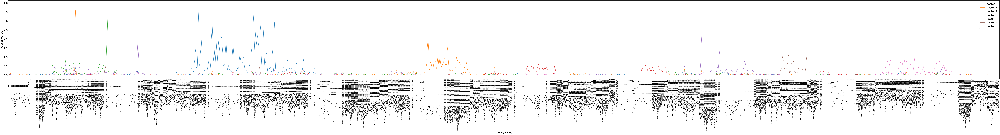

In [13]:
W['transition']=['{} -> {}'.format(i[0], i[1]) for i in commoparable_transitions.index[W.index]]
W['next_app']=commoparable_transitions.reset_index()['next_app']

W=W.sort_values(['next_app','transition'])
W=W.drop(columns=['next_app'])

plt.figure(figsize=(245, 20), dpi=80)
plt.plot(W['transition'],W[0],label='factor 0')
plt.plot(W['transition'],W[1],label='factor 1')
plt.plot(W['transition'],W[2],label='factor 2')
plt.plot(W['transition'],W[3],label='factor 3')
plt.plot(W['transition'],W[4],label='factor 4')
plt.plot(W['transition'],W[5],label='factor 5')
plt.plot(W['transition'],W[6],label='factor 6')
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=35)
plt.legend(fontsize=35) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=40)
plt.ylabel('Factor value',fontsize=40)
plt.show()

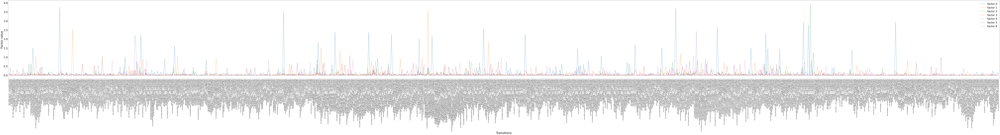

In [14]:
W['next_app']=commoparable_transitions.reset_index()['next_app']
W=W.sort_values(['transition','next_app'])
W=W.drop(columns=['next_app'])

plt.figure(figsize=(245, 20), dpi=80)
plt.plot(W['transition'],W[0],label='factor 0')
plt.plot(W['transition'],W[1],label='factor 1')
plt.plot(W['transition'],W[2],label='factor 2')
plt.plot(W['transition'],W[3],label='factor 3')
plt.plot(W['transition'],W[4],label='factor 4')
plt.plot(W['transition'],W[5],label='factor 5')
plt.plot(W['transition'],W[6],label='factor 6')
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=35)
plt.legend(fontsize=35) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=40)
plt.ylabel('Factor value',fontsize=40)
plt.show()

**Blue:**
- ... -> facebook
- What's New APK -> facebook
- movie creator -> facebook
- ... -> messenger
- facebook -> googe
- facebook -> shell
- facebook -> Royal Bank of Scotland 
- facebook -> timehop
- facebook -> whatsapp


**Orange:**
- google -> chrome
- ... -> google

**Green:**
- amazone -> chrome
- ebay -> chrome
- facebook -> chrome
- photos -> chrome
- gmail -> chrome
- outlook -> chrome
- album -> chrome
- Lounge -> chrome
- experia weather -> chrome
- news suite -> facebook
- news suite -> facebook
- chrome -> weather

**Red:**
- snapchat -> facebook
- ... -> messenger
- snapchat -> youtube
- ... -> instagram
- ... -> snapchat
- ... -> music
- instagram -> whatsapp


**Purpel:**
- call -> chrome
- office -> chrome
- album -> chrome
- Lounge -> chrome
- google -> call
- album -> call
- phonebook -> call
- coversations -> call
- conversations -> facebook
- calender -> facebook
- call -> maps
- call -> google
- phonebook -> google
- ... -> phonebook
- ... -> conversations
- office -> conversations
- call -> whatsapp
- phonebook -> whatsapp
- video -> whatsapp



**Brown:**
- email -> chrome
- email -> facebook
- email -> chrome
- ... -> email
- email -> whatsapp

**Pink:**
- whatsapp -> facebook
- whatsapp -> instagram
- whatsapp -> uber
- ... -> whatsapp
- Barclays mobile banking -> whatsapp
- Citymapper -> whatsapp
- shell -> whatsapp
- google music -> whatsapp


Overall we observe patterns similar to before those found before the normalization, however some of the lesser known apps are have become more prominent with higher component values.


### User loadings
We now take a look at how the different users behave based on their loadings of the components.

In [14]:
test=H.transpose()
test['max_factor']=H.idxmax()
test=test.sort_values('max_factor')

group=test.groupby('max_factor')
groups=[]
for i in range(7):
    group_i=group.get_group(i)
    group_i["2_highest"]=group_i.drop(columns=[i,'max_factor']).idxmax(axis=1)
    groups.append(group_i)
test=pd.concat(groups)
group=test.groupby(['max_factor','2_highest'])
groups=[]
for i,j in group:
    group_i=j
    group_i["3_highest"]=group_i.drop(columns=[i[0],i[1],'max_factor','2_highest']).idxmax(axis=1)
    groups.append(group_i)
test=pd.concat(groups)
group=test.groupby(['max_factor','2_highest',"3_highest"])
groups=[]
for i,j in group:
    group_i=j
    group_i["4_highest"]=group_i.drop(columns=[i[0],i[1],i[2],"3_highest",'max_factor','2_highest']).idxmax(axis=1)
    groups.append(group_i)
test=pd.concat(groups)
group=test.groupby(['max_factor','2_highest',"3_highest","4_highest"])
groups=[]
for i,j in group:
    group_i=j
    group_i["5_highest"]=group_i.drop(columns=[i[0],i[1],i[2],i[3],"4_highest","3_highest",'max_factor','2_highest']).idxmax(axis=1)
    groups.append(group_i)
test=pd.concat(groups)
group=test.groupby(['max_factor','2_highest',"3_highest","4_highest","5_highest"])
groups=[]
for i,j in group:
    group_i=j
    group_i["6_highest"]=group_i.drop(columns=[i[0],i[1],i[2],i[3],i[4],"5_highest","4_highest","3_highest",'max_factor','2_highest']).idxmax(axis=1)
    groups.append(group_i)
test=pd.concat(groups)

test.reset_index(inplace=True)

<ipython-input-14-34342836592f>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_i["2_highest"]=group_i.drop(columns=[i,'max_factor']).idxmax(axis=1)


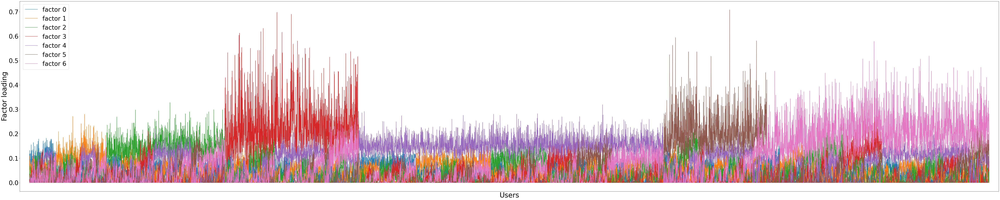

In [18]:
plt.figure(figsize=(100, 20), dpi=80)
plt.plot(test.index,test[0],label='factor 0')
plt.plot(test.index,test[1],label='factor 1')
plt.plot(test.index,test[2],label='factor 2')
plt.plot(test.index,test[3],label='factor 3')
plt.plot(test.index,test[4],label='factor 4')
plt.plot(test.index,test[5],label='factor 5')
plt.plot(test.index,test[6],label='factor 6')
plt.yticks(fontsize=35)
plt.legend(fontsize=35) 
plt.margins(x=0.01)
plt.xlabel('Users',fontsize=40)
plt.xticks([])  
plt.ylabel('Factor loading',fontsize=40)
plt.show()

The user loadings does look quit different than before.

In [11]:
commoparable_transitions2=commoparable_transitions.set_index(commoparable_transitions.reset_index().package_name+"->"+commoparable_transitions.reset_index().next_app)

In [12]:
commoparable_transitions['transition']=commoparable_transitions2.index

In [15]:
test=test.rename(columns={'index':'user_id'})

top_500_factor_0_loadings=test.nlargest(500,0).user_id
top_500_factor_1_loadings=test.nlargest(500,1).user_id
top_500_factor_2_loadings=test.nlargest(500,2).user_id
top_500_factor_3_loadings=test.nlargest(500,3).user_id
top_500_factor_4_loadings=test.nlargest(500,4).user_id
top_500_factor_5_loadings=test.nlargest(500,5).user_id
top_500_factor_6_loadings=test.nlargest(500,6).user_id

No handles with labels found to put in legend.


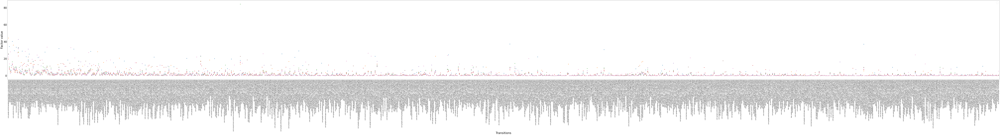

In [22]:
plt.figure(figsize=(245, 20), dpi=80)
plt.scatter(commoparable_transitions2.index,commoparable_transitions[top_500_factor_0_loadings].mean(axis=1))
plt.scatter(commoparable_transitions2.index,commoparable_transitions[top_500_factor_1_loadings].mean(axis=1))
plt.scatter(commoparable_transitions2.index,commoparable_transitions[top_500_factor_2_loadings].mean(axis=1))
plt.scatter(commoparable_transitions2.index,commoparable_transitions[top_500_factor_3_loadings].mean(axis=1))
plt.scatter(commoparable_transitions2.index,commoparable_transitions[top_500_factor_4_loadings].mean(axis=1))
plt.scatter(commoparable_transitions2.index,commoparable_transitions[top_500_factor_5_loadings].mean(axis=1))
plt.scatter(commoparable_transitions2.index,commoparable_transitions[top_500_factor_6_loadings].mean(axis=1))
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=35)
plt.legend(fontsize=35) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=40)
plt.ylabel('Factor value',fontsize=40)
plt.show()

In [31]:
commoparable_transitions=commoparable_transitions.reset_index().sort_values(['package_name','next_app']).set_index(['package_name','next_app'])

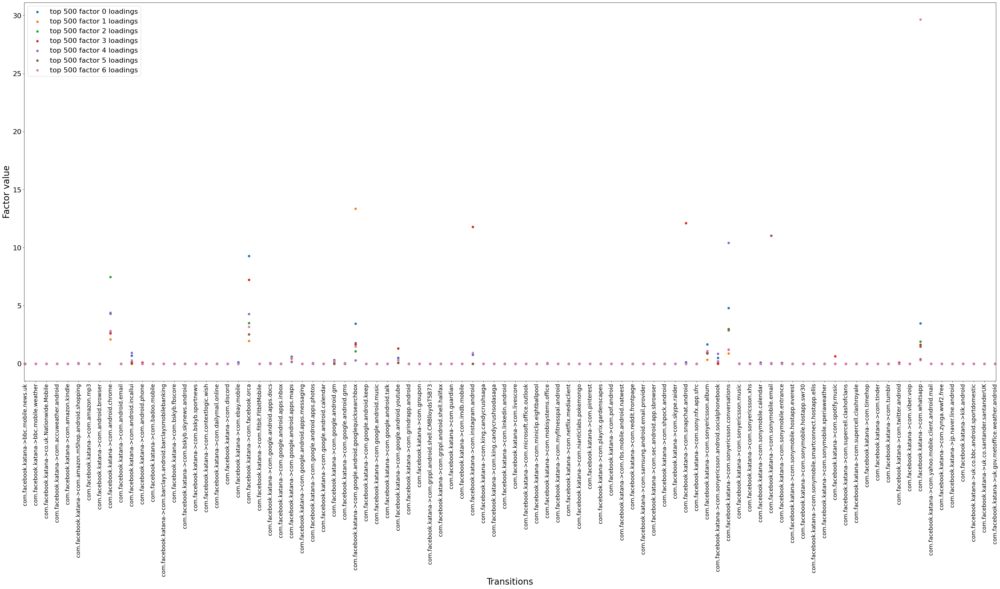

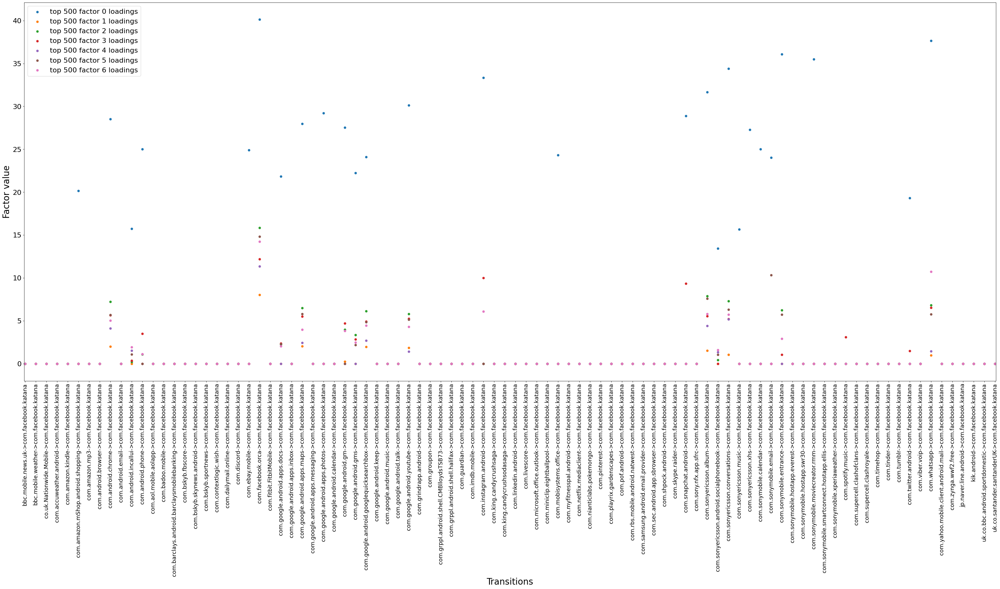

In [32]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.facebook.katana',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.facebook.katana',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.katana',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.facebook.katana',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.katana',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.facebook.katana',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.katana',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.facebook.katana',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.katana',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.facebook.katana',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.katana',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.facebook.katana',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.katana',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.facebook.katana',:,:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.facebook.katana',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.facebook.katana',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.katana',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.facebook.katana',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.katana',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.facebook.katana',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.katana',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.facebook.katana',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.katana',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.facebook.katana',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.katana',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.facebook.katana',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.katana',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.facebook.katana',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

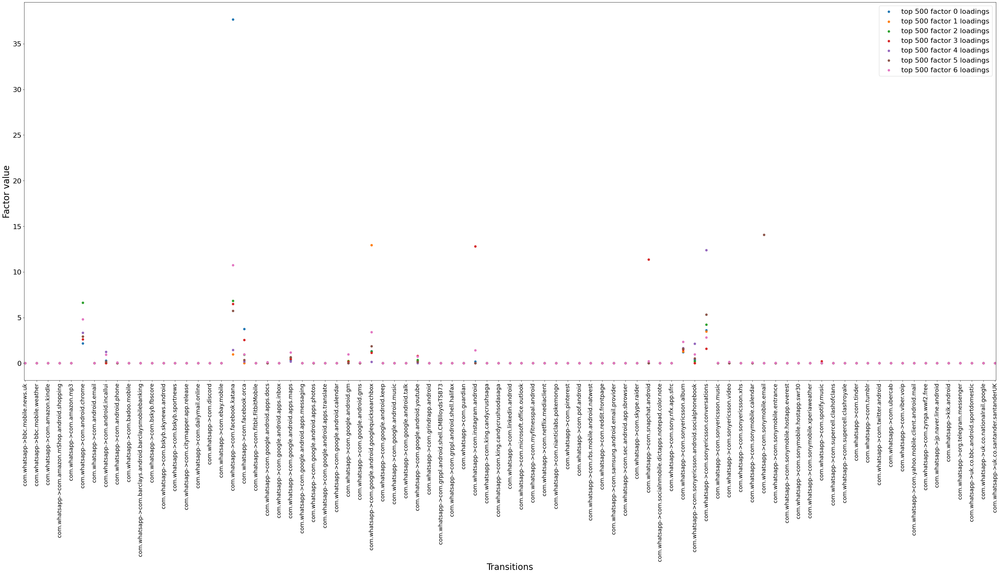

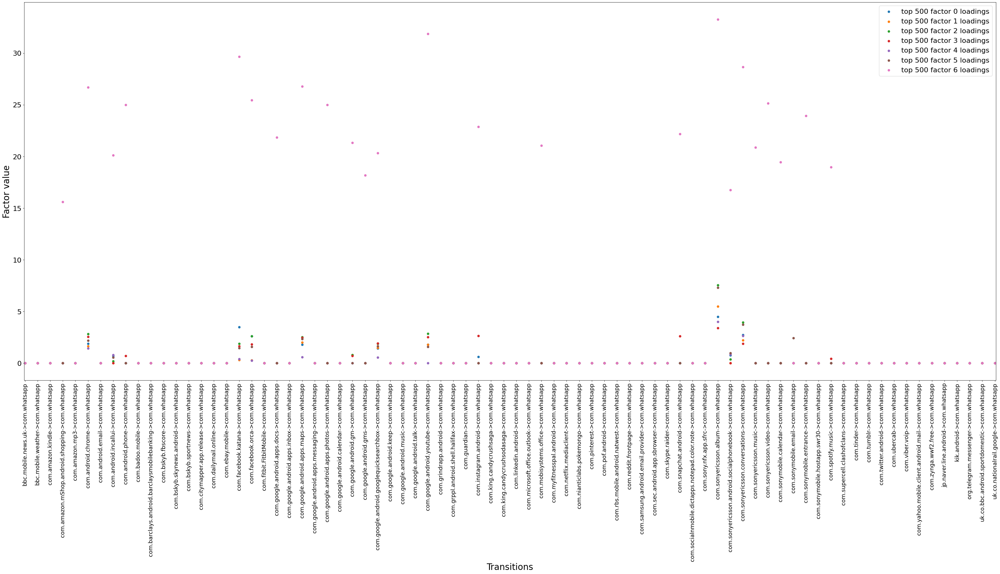

In [34]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.whatsapp',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.whatsapp',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.whatsapp',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.whatsapp',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.whatsapp',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.whatsapp',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.whatsapp',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.whatsapp',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.whatsapp',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.whatsapp',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.whatsapp',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.whatsapp',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.whatsapp',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.whatsapp',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.whatsapp',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.whatsapp',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.whatsapp',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.whatsapp',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.whatsapp',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.whatsapp',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.whatsapp',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.whatsapp',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.whatsapp',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.whatsapp',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.whatsapp',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.whatsapp',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.whatsapp',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.whatsapp',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

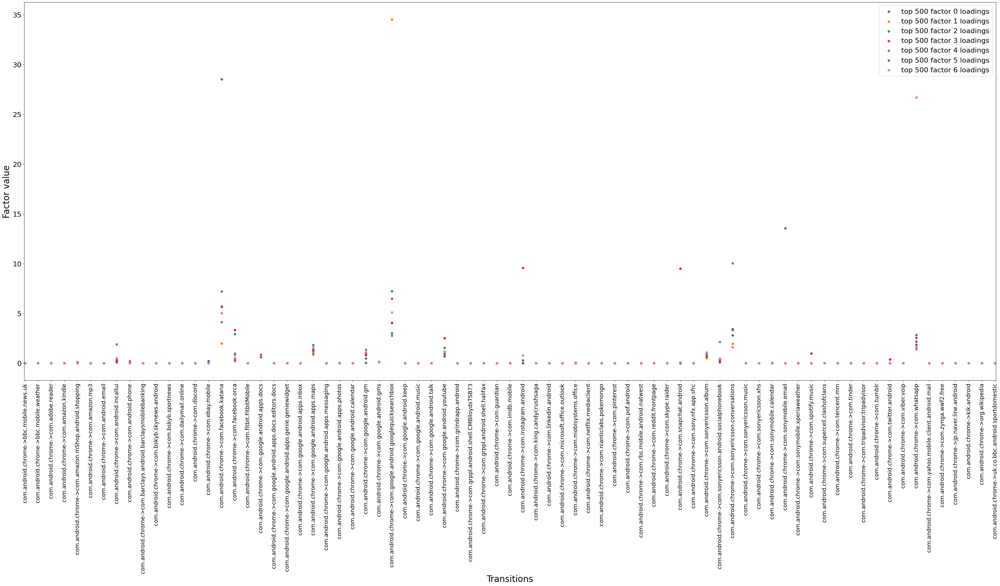

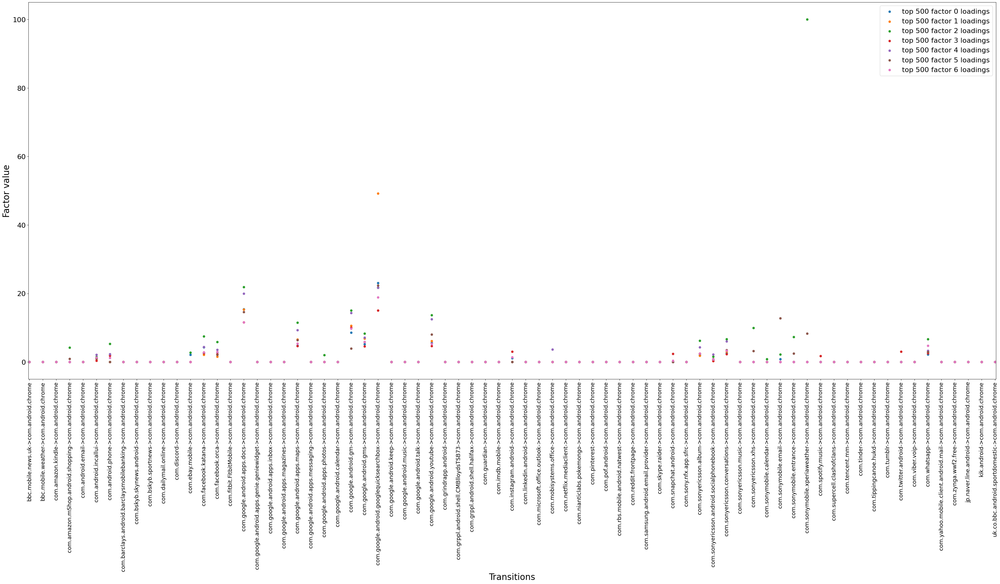

In [44]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.android.chrome',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.android.chrome',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.android.chrome',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.android.chrome',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.android.chrome',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.android.chrome',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.android.chrome',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.android.chrome',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.android.chrome',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.android.chrome',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.android.chrome',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.android.chrome',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.android.chrome',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.android.chrome',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.android.chrome',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.android.chrome',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.android.chrome',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.android.chrome',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.android.chrome',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.android.chrome',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.android.chrome',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.android.chrome',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.android.chrome',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.android.chrome',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.android.chrome',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.android.chrome',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.android.chrome',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.android.chrome',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()


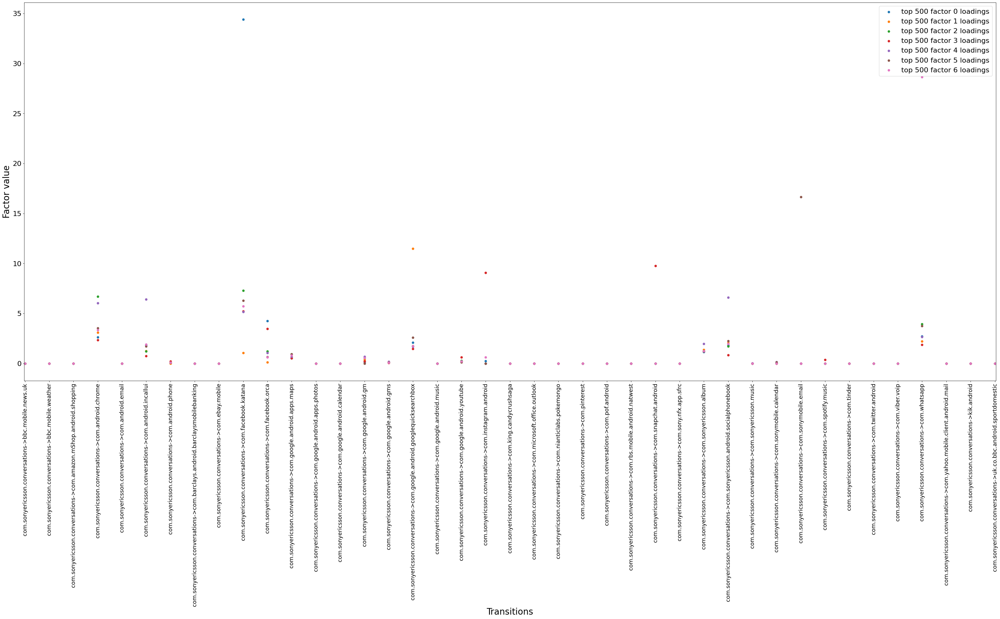

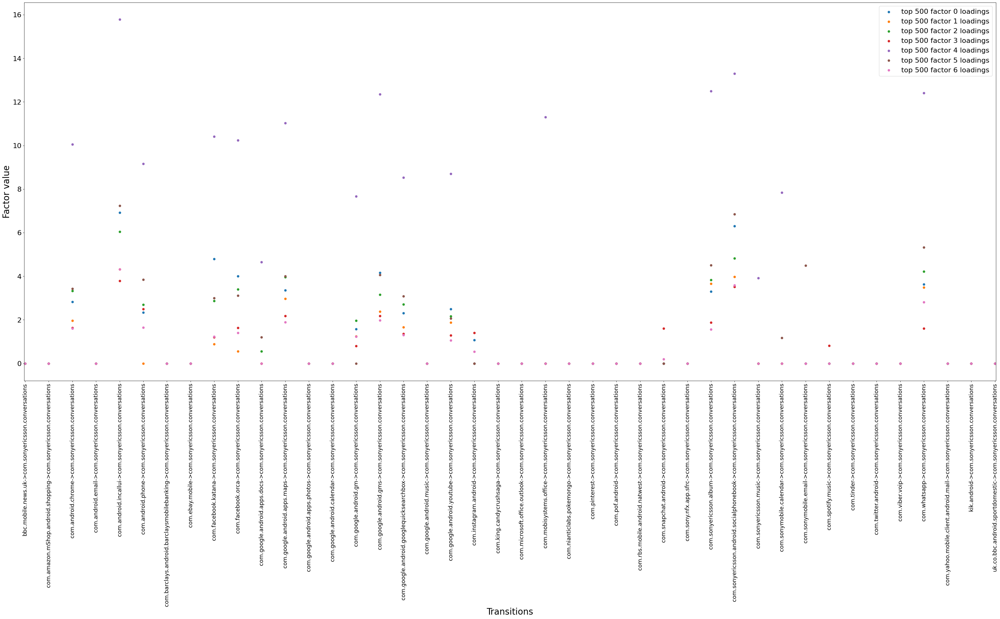

In [45]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.sonyericsson.conversations',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.sonyericsson.conversations',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.sonyericsson.conversations',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.sonyericsson.conversations',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.sonyericsson.conversations',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.sonyericsson.conversations',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.sonyericsson.conversations',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.sonyericsson.conversations',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.sonyericsson.conversations',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.sonyericsson.conversations',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.sonyericsson.conversations',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.sonyericsson.conversations',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.sonyericsson.conversations',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.sonyericsson.conversations',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.sonyericsson.conversations',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.sonyericsson.conversations',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonyericsson.conversations',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.sonyericsson.conversations',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonyericsson.conversations',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.sonyericsson.conversations',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonyericsson.conversations',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.sonyericsson.conversations',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonyericsson.conversations',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.sonyericsson.conversations',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonyericsson.conversations',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.sonyericsson.conversations',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonyericsson.conversations',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.sonyericsson.conversations',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

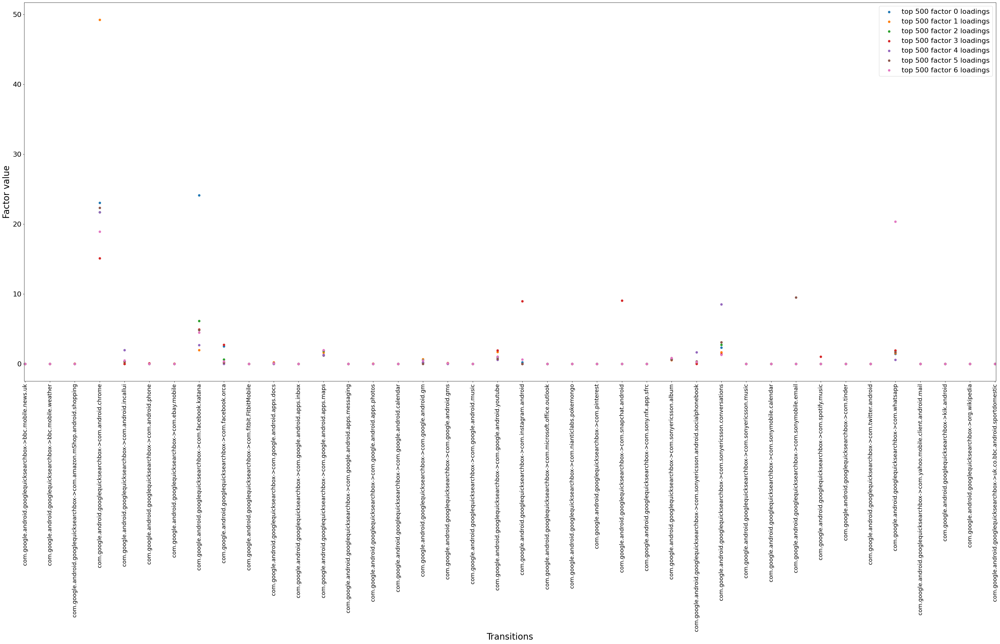

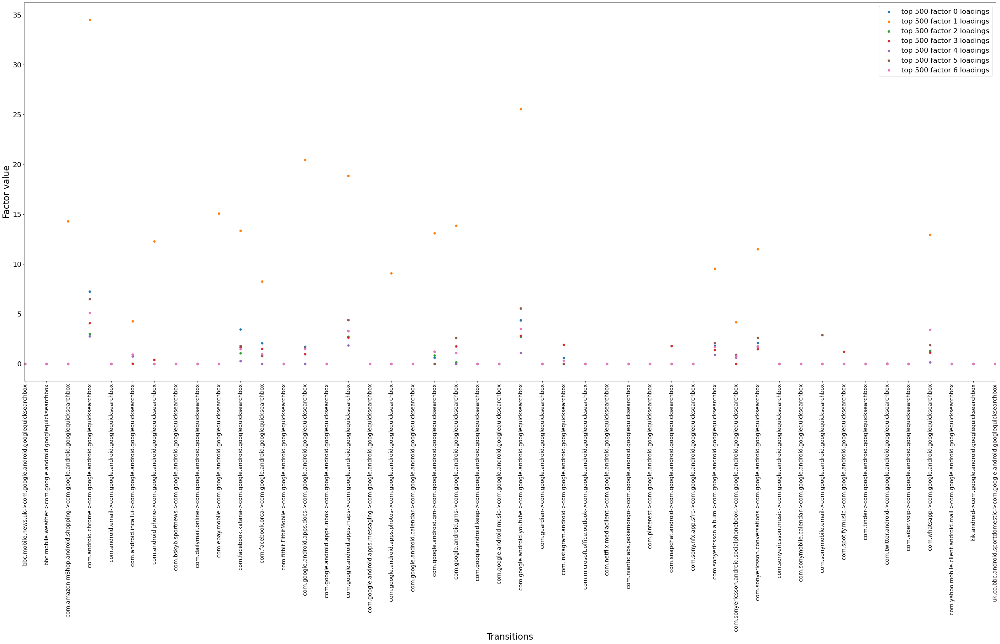

In [46]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.google.android.googlequicksearchbox',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.google.android.googlequicksearchbox',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.googlequicksearchbox',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.google.android.googlequicksearchbox',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.googlequicksearchbox',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.google.android.googlequicksearchbox',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.googlequicksearchbox',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.google.android.googlequicksearchbox',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.googlequicksearchbox',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.google.android.googlequicksearchbox',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.googlequicksearchbox',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.google.android.googlequicksearchbox',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.googlequicksearchbox',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.google.android.googlequicksearchbox',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.google.android.googlequicksearchbox',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.google.android.googlequicksearchbox',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.googlequicksearchbox',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.google.android.googlequicksearchbox',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.googlequicksearchbox',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.google.android.googlequicksearchbox',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.googlequicksearchbox',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.google.android.googlequicksearchbox',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.googlequicksearchbox',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.google.android.googlequicksearchbox',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.googlequicksearchbox',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.google.android.googlequicksearchbox',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.googlequicksearchbox',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.google.android.googlequicksearchbox',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

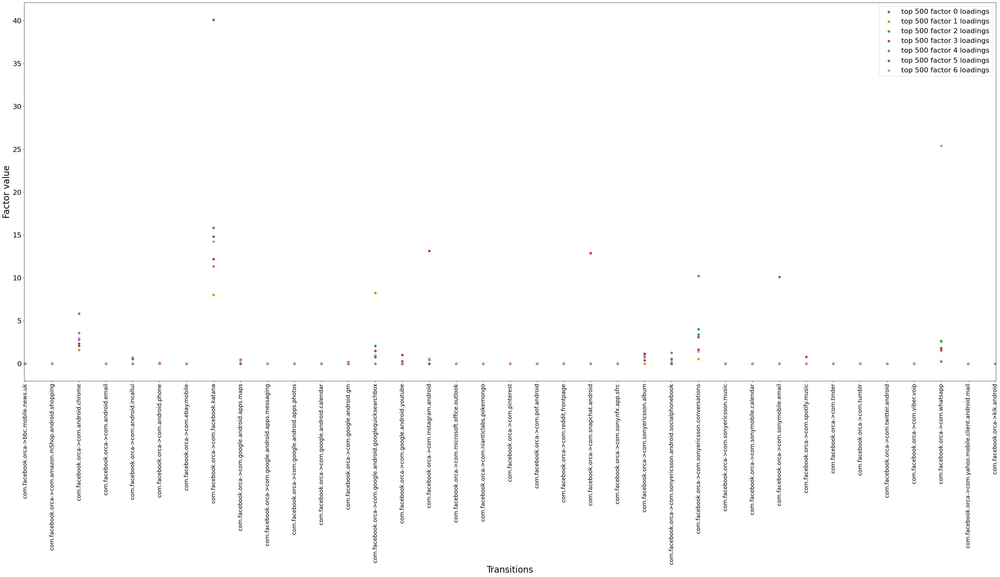

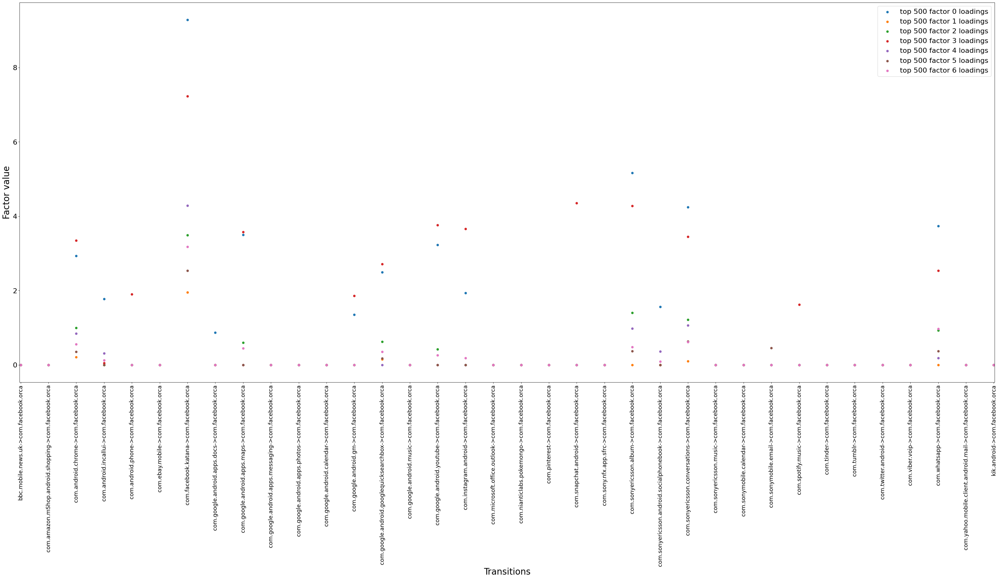

In [38]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.facebook.orca',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.facebook.orca',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.orca',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.facebook.orca',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.orca',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.facebook.orca',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.orca',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.facebook.orca',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.orca',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.facebook.orca',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.orca',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.facebook.orca',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.facebook.orca',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.facebook.orca',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.facebook.orca',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.facebook.orca',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.orca',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.facebook.orca',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.orca',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.facebook.orca',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.orca',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.facebook.orca',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.orca',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.facebook.orca',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.orca',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.facebook.orca',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.facebook.orca',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.facebook.orca',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

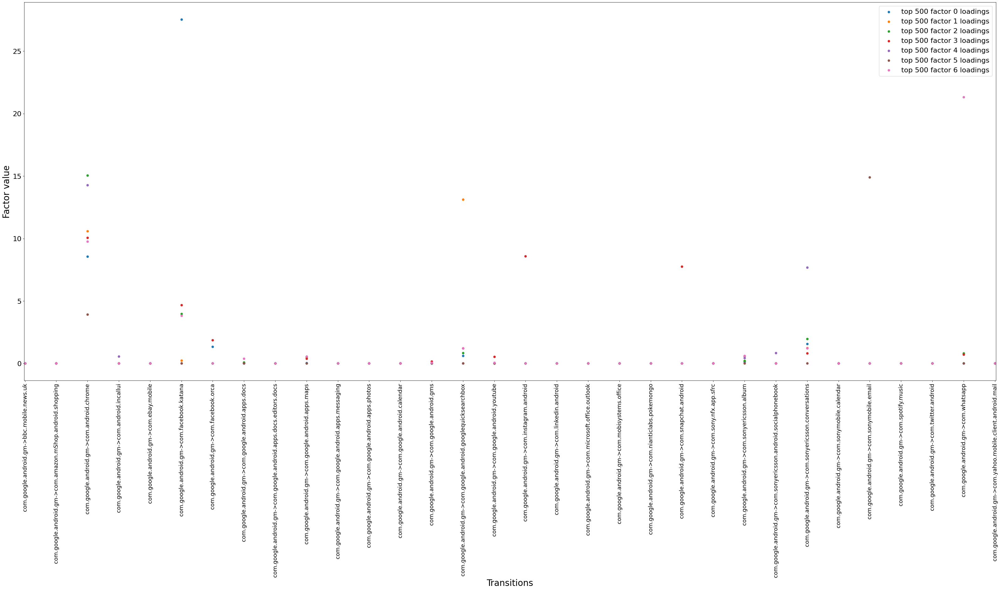

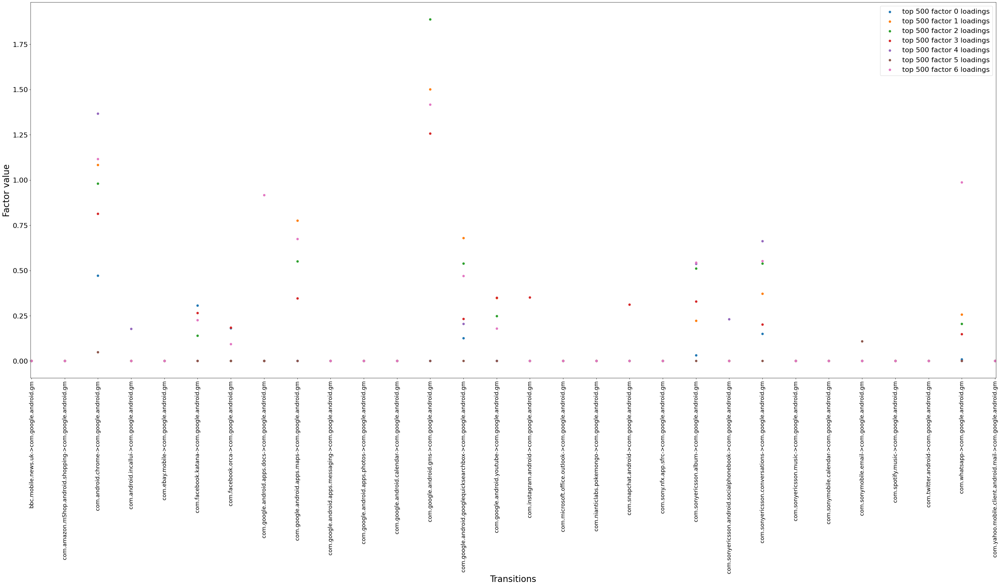

In [47]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.google.android.gm',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.google.android.gm',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.gm',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.google.android.gm',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.gm',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.google.android.gm',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.gm',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.google.android.gm',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.gm',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.google.android.gm',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.gm',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.google.android.gm',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.google.android.gm',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.google.android.gm',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.google.android.gm',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.google.android.gm',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.gm',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.google.android.gm',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.gm',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.google.android.gm',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.gm',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.google.android.gm',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.gm',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.google.android.gm',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.gm',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.google.android.gm',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.google.android.gm',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.google.android.gm',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

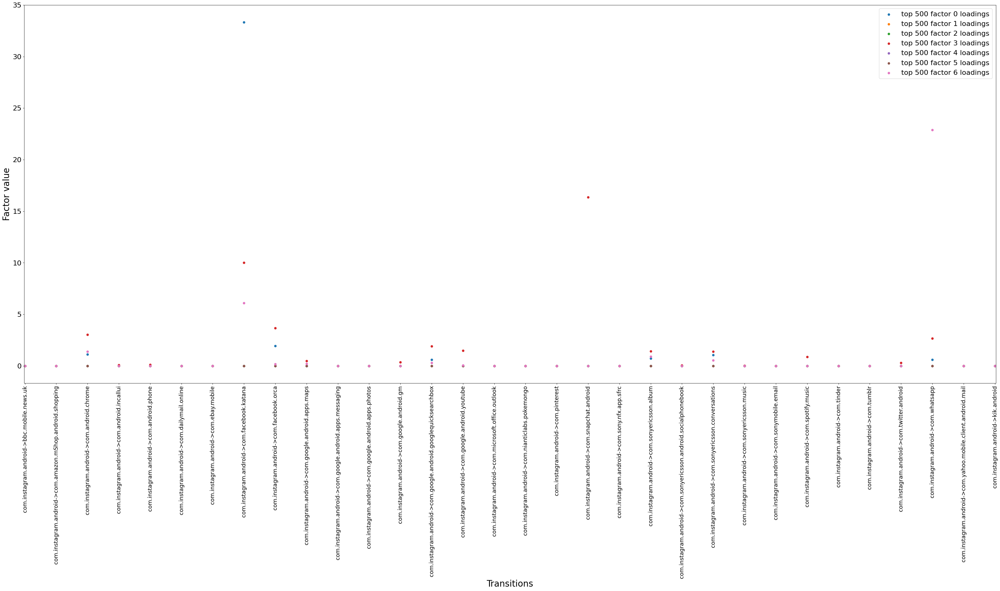

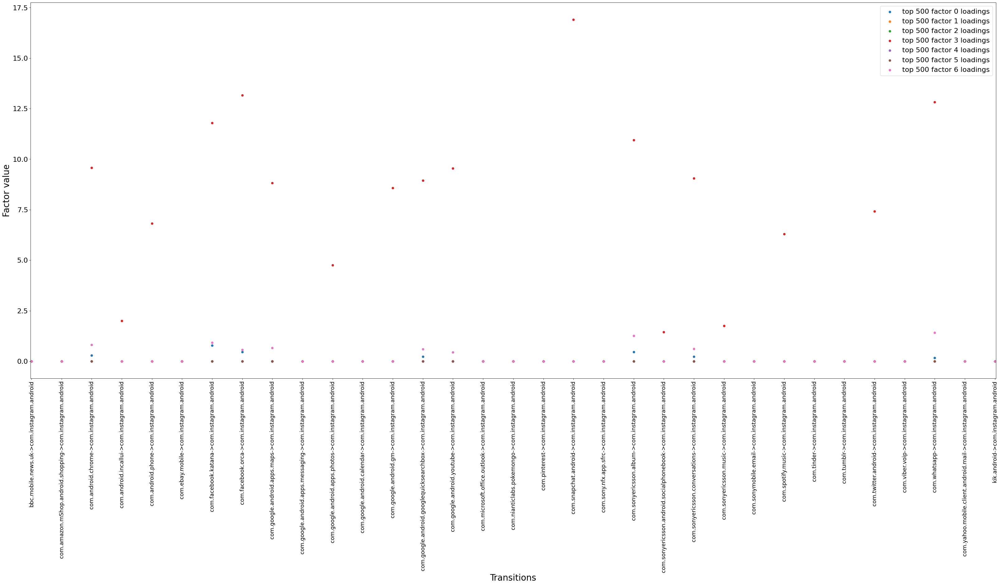

In [40]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.instagram.android',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.instagram.android',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.instagram.android',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.instagram.android',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.instagram.android',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.instagram.android',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.instagram.android',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.instagram.android',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.instagram.android',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.instagram.android',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.instagram.android',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.instagram.android',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.instagram.android',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.instagram.android',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.instagram.android',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.instagram.android',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.instagram.android',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.instagram.android',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.instagram.android',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.instagram.android',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.instagram.android',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.instagram.android',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.instagram.android',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.instagram.android',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.instagram.android',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.instagram.android',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.instagram.android',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.instagram.android',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

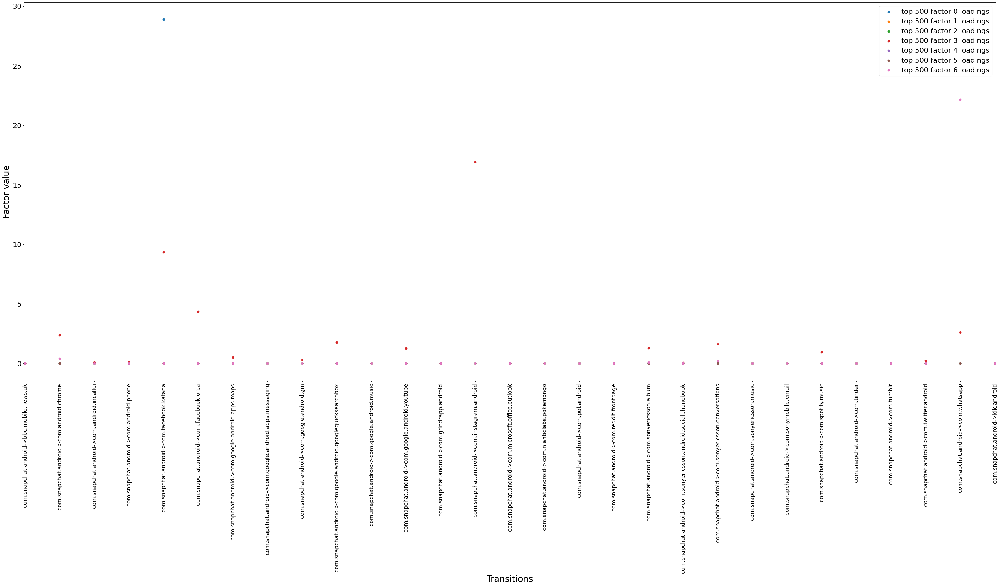

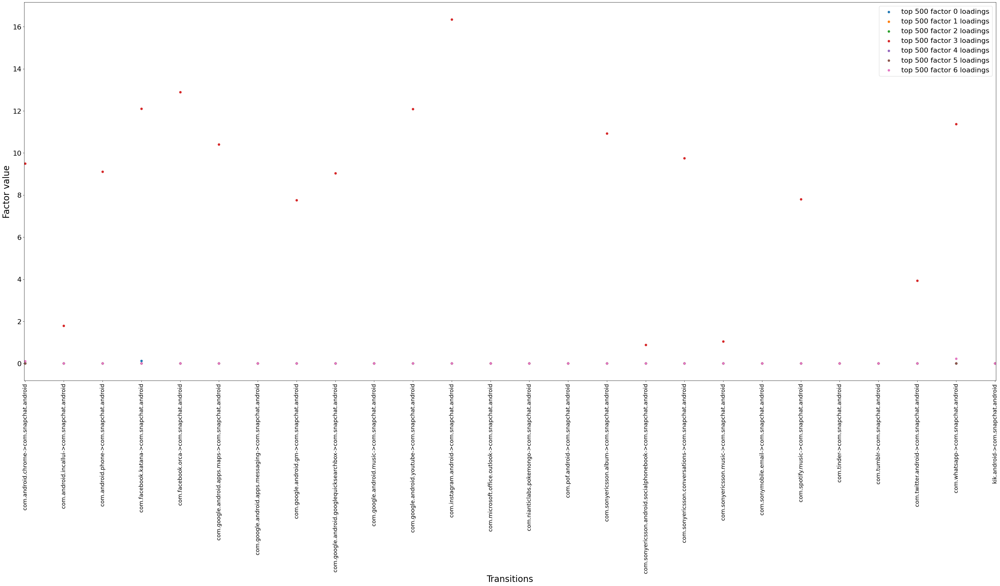

In [48]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.snapchat.android',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.snapchat.android',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.snapchat.android',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.snapchat.android',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.snapchat.android',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.snapchat.android',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.snapchat.android',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.snapchat.android',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.snapchat.android',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.snapchat.android',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.snapchat.android',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.snapchat.android',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.snapchat.android',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.snapchat.android',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.snapchat.android',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.snapchat.android',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.snapchat.android',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.snapchat.android',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.snapchat.android',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.snapchat.android',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.snapchat.android',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.snapchat.android',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.snapchat.android',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.snapchat.android',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.snapchat.android',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.snapchat.android',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.snapchat.android',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.snapchat.android',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

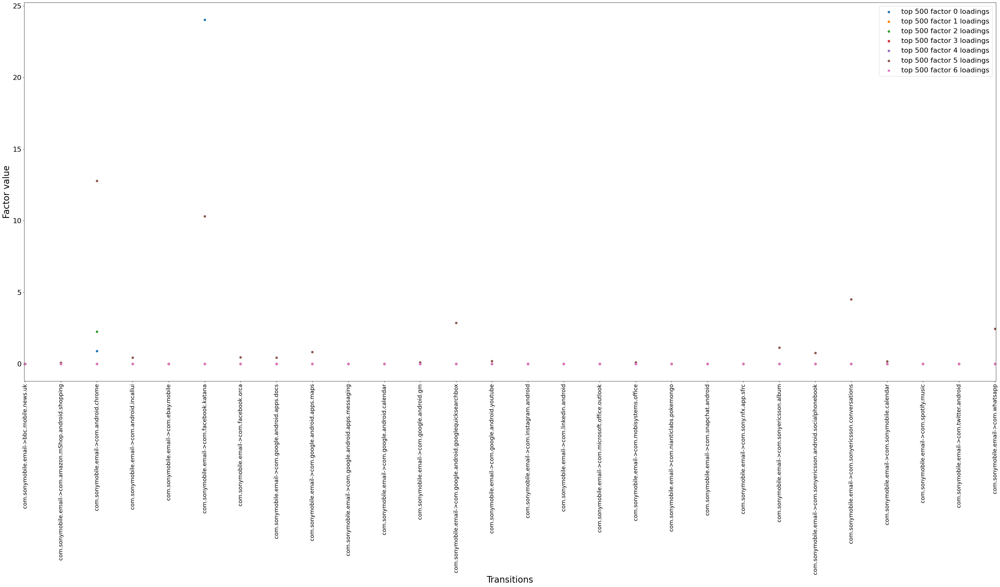

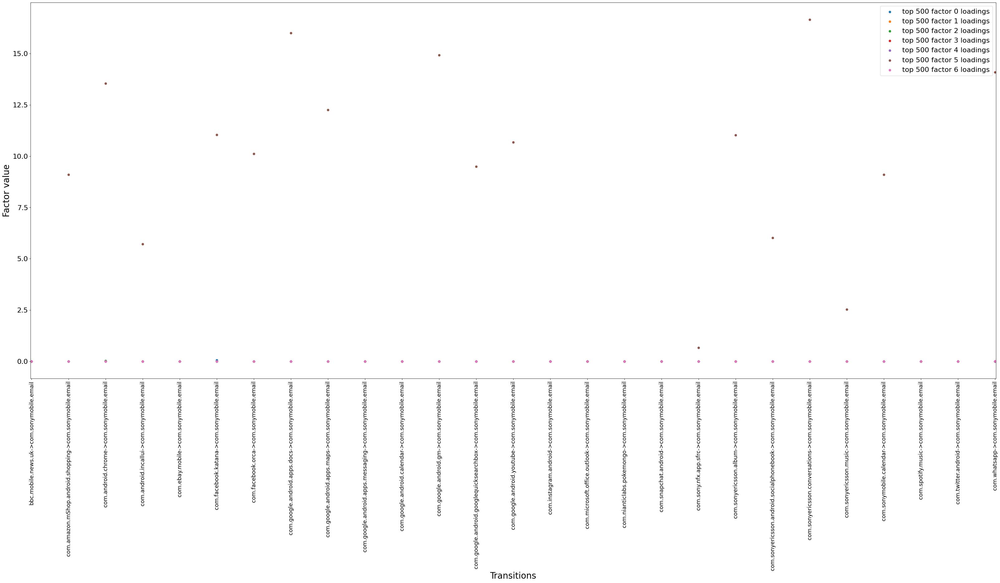

In [42]:
plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc['com.sonymobile.email',:,:].transition,commoparable_transitions[top_500_factor_0_loadings].loc['com.sonymobile.email',:,:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc['com.sonymobile.email',:,:].transition,commoparable_transitions[top_500_factor_1_loadings].loc['com.sonymobile.email',:,:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc['com.sonymobile.email',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc['com.sonymobile.email',:,:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc['com.sonymobile.email',:,:].transition,commoparable_transitions[top_500_factor_3_loadings].loc['com.sonymobile.email',:,:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc['com.sonymobile.email',:,:].transition,commoparable_transitions[top_500_factor_4_loadings].loc['com.sonymobile.email',:,:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc['com.sonymobile.email',:,:].transition,commoparable_transitions[top_500_factor_5_loadings].loc['com.sonymobile.email',:,:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc['com.sonymobile.email',:,:].transition,commoparable_transitions[top_500_factor_6_loadings].loc['com.sonymobile.email',:,:].median(axis=1),label="top 500 factor 6 loadings")
plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

plt.figure(figsize=(50, 20), dpi=80)
plt.scatter(commoparable_transitions.loc[:,'com.sonymobile.email',:].transition,commoparable_transitions[top_500_factor_0_loadings].loc[:,'com.sonymobile.email',:].median(axis=1),label="top 500 factor 0 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonymobile.email',:].transition,commoparable_transitions[top_500_factor_1_loadings].loc[:,'com.sonymobile.email',:].median(axis=1),label="top 500 factor 1 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonymobile.email',:,:].transition,commoparable_transitions[top_500_factor_2_loadings].loc[:,'com.sonymobile.email',:].median(axis=1),label="top 500 factor 2 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonymobile.email',:].transition,commoparable_transitions[top_500_factor_3_loadings].loc[:,'com.sonymobile.email',:].median(axis=1),label="top 500 factor 3 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonymobile.email',:].transition,commoparable_transitions[top_500_factor_4_loadings].loc[:,'com.sonymobile.email',:].median(axis=1), label="top 500 factor 4 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonymobile.email',:].transition,commoparable_transitions[top_500_factor_5_loadings].loc[:,'com.sonymobile.email',:].median(axis=1),label="top 500 factor 5 loadings")
plt.scatter(commoparable_transitions.loc[:,'com.sonymobile.email',:].transition,commoparable_transitions[top_500_factor_6_loadings].loc[:,'com.sonymobile.email',:].median(axis=1),label="top 500 factor 6 loadings")

plt.xticks(fontsize=16, rotation=90)
plt.yticks(fontsize=20)
plt.legend(fontsize=20) 
plt.margins(x=0.001)
plt.xlabel('Transitions',fontsize=25)
plt.ylabel('Factor value',fontsize=25)
plt.show()

## N-grams for top 500 user lodings
In this section we take a look at how the different users, with high loadings for each of the factors, patterns behave on a larger scale. To do this we return to the N-grams.

In [16]:
data=data.set_index('user_id')

In [17]:
corpus_top_500_factor_0_loadings=data.loc[top_500_factor_0_loadings].reset_index().groupby(['user_id','session']).package_name.apply(' '.join)
corpus_top_500_factor_1_loadings=data.loc[top_500_factor_1_loadings].reset_index().groupby(['user_id','session']).package_name.apply(' '.join)
corpus_top_500_factor_2_loadings=data.loc[top_500_factor_2_loadings].reset_index().groupby(['user_id','session']).package_name.apply(' '.join)
corpus_top_500_factor_3_loadings=data.loc[top_500_factor_3_loadings].reset_index().groupby(['user_id','session']).package_name.apply(' '.join)
corpus_top_500_factor_4_loadings=data.loc[top_500_factor_4_loadings].reset_index().groupby(['user_id','session']).package_name.apply(' '.join)
corpus_top_500_factor_5_loadings=data.loc[top_500_factor_5_loadings].reset_index().groupby(['user_id','session']).package_name.apply(' '.join)
corpus_top_500_factor_6_loadings=data.loc[top_500_factor_6_loadings].reset_index().groupby(['user_id','session']).package_name.apply(' '.join)

In [51]:
print(corpus_top_500_factor_0_loadings.shape[0]/100*0.25)
print(corpus_top_500_factor_1_loadings.shape[0]/100*0.25)
print(corpus_top_500_factor_2_loadings.shape[0]/100*0.25)
print(corpus_top_500_factor_3_loadings.shape[0]/100*0.25)
print(corpus_top_500_factor_4_loadings.shape[0]/100*0.25)
print(corpus_top_500_factor_5_loadings.shape[0]/100*0.25)
print(corpus_top_500_factor_6_loadings.shape[0]/100*0.25)

11040.665
8514.235
9328.6775
12009.3425
7012.5175
9051.2675
12515.1775


## Frequent apps

In [33]:
vectorizer_1_f0 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(1,1),lowercase=False)
vectorization_1_f0=vectorizer_1_f0.fit_transform(corpus_top_500_factor_0_loadings.values)
print("Number of frequent apps:",len(vectorizer_1_f0.get_feature_names_out()[np.where((vectorization_1_f0>0).sum(axis=0)>=11041)[1]]))
pd.DataFrame(vectorizer_1_f0.get_feature_names_out()[np.where((vectorization_1_f0>0).sum(axis=0)>=11041)[1]]).to_csv("NMFrow_f0_1grmas.csv")
vectorizer_1_f0.get_feature_names_out()[np.where((vectorization_1_f0>0).sum(axis=0)>=11041)[1]]

Number of frequent apps: 56


array(['bbc.mobile.news.uk', 'bbc.mobile.weather',
       'com.amazon.mShop.android.shopping', 'com.amazon.mp3',
       'com.android.chrome', 'com.android.email', 'com.android.incallui',
       'com.android.phone', 'com.barclays.android.barclaysmobilebanking',
       'com.bskyb.skynews.android', 'com.bskyb.sportnews',
       'com.contextlogic.wish', 'com.ebay.mobile', 'com.facebook.katana',
       'com.facebook.orca', 'com.fitbit.FitbitMobile',
       'com.google.android.apps.docs', 'com.google.android.apps.maps',
       'com.google.android.apps.messaging',
       'com.google.android.apps.photos', 'com.google.android.calendar',
       'com.google.android.gm', 'com.google.android.gms',
       'com.google.android.googlequicksearchbox',
       'com.google.android.music', 'com.google.android.talk',
       'com.google.android.youtube',
       'com.grppl.android.shell.CMBlloydsTSB73',
       'com.grppl.android.shell.halifax', 'com.guardian',
       'com.instagram.android', 'com.king.candycru

In [70]:
pd.read_csv("NMFrow_f0_1grmas.csv").

,Unnamed: 0,0
0,0,bbc.mobile.news.uk
1,1,bbc.mobile.weather
2,2,com.amazon.mShop.android.shopping
3,3,com.amazon.mp3
4,4,com.android.chrome
5,5,com.android.email
6,6,com.android.incallui
7,7,com.android.phone
8,8,com.barclays.android.barclaysmobilebanking
9,9,com.bskyb.skynews.android


In [34]:
vectorizer_1_f1 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(1,1),lowercase=False)
vectorization_1_f1=vectorizer_1_f1.fit_transform(corpus_top_500_factor_1_loadings.values)
print("Number of frequent apps:",len(vectorizer_1_f1.get_feature_names_out()[np.where((vectorization_1_f1>0).sum(axis=0)>=8515)[1]]))
pd.DataFrame(vectorizer_1_f1.get_feature_names_out()[np.where((vectorization_1_f1>0).sum(axis=0)>=8515)[1]]).to_csv("NMFrow_f1_1grmas.csv")
vectorizer_1_f1.get_feature_names_out()[np.where((vectorization_1_f1>0).sum(axis=0)>=8515)[1]]

Number of frequent apps: 69


array(['bbc.mobile.news.uk', 'bbc.mobile.weather', 'com.amazon.kindle',
       'com.amazon.mShop.android.shopping', 'com.amazon.mp3',
       'com.android.chrome', 'com.android.email', 'com.android.incallui',
       'com.android.phone', 'com.barclays.android.barclaysmobilebanking',
       'com.bskyb.fbscore', 'com.bskyb.skynews.android',
       'com.bskyb.sportnews', 'com.dailymail.online', 'com.ebay.mobile',
       'com.facebook.katana', 'com.facebook.orca',
       'com.fitbit.FitbitMobile', 'com.google.android.apps.docs',
       'com.google.android.apps.genie.geniewidget',
       'com.google.android.apps.inbox',
       'com.google.android.apps.magazines',
       'com.google.android.apps.maps',
       'com.google.android.apps.messaging',
       'com.google.android.apps.photos', 'com.google.android.calendar',
       'com.google.android.gm', 'com.google.android.gms',
       'com.google.android.googlequicksearchbox',
       'com.google.android.keep', 'com.google.android.music',
       'co

In [35]:
vectorizer_1_f2 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(1,1),lowercase=False)
vectorization_1_f2=vectorizer_1_f2.fit_transform(corpus_top_500_factor_2_loadings.values)
print("Number of frequent apps:",len(vectorizer_1_f2.get_feature_names_out()[np.where((vectorization_1_f2>0).sum(axis=0)>=9329)[1]]))
pd.DataFrame(vectorizer_1_f2.get_feature_names_out()[np.where((vectorization_1_f2>0).sum(axis=0)>=9329)[1]]).to_csv("NMFrow_f2_1grmas.csv")
vectorizer_1_f2.get_feature_names_out()[np.where((vectorization_1_f2>0).sum(axis=0)>=9329)[1]]

Number of frequent apps: 67


array(['bbc.mobile.news.uk', 'bbc.mobile.weather', 'com.amazon.kindle',
       'com.amazon.mShop.android.shopping', 'com.amazon.mp3',
       'com.android.chrome', 'com.android.email', 'com.android.incallui',
       'com.android.phone', 'com.barclays.android.barclaysmobilebanking',
       'com.bskyb.skynews.android', 'com.bskyb.sportnews',
       'com.ebay.mobile', 'com.facebook.katana', 'com.facebook.orca',
       'com.fitbit.FitbitMobile', 'com.google.android.apps.docs',
       'com.google.android.apps.genie.geniewidget',
       'com.google.android.apps.maps',
       'com.google.android.apps.messaging',
       'com.google.android.apps.photos', 'com.google.android.calendar',
       'com.google.android.gm', 'com.google.android.gms',
       'com.google.android.googlequicksearchbox',
       'com.google.android.keep', 'com.google.android.music',
       'com.google.android.talk', 'com.google.android.youtube',
       'com.grppl.android.shell.CMBlloydsTSB73',
       'com.grppl.android.shell.h

In [36]:
vectorizer_1_f3 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(1,1),lowercase=False)
vectorization_1_f3=vectorizer_1_f3.fit_transform(corpus_top_500_factor_3_loadings.values)
print("Number of frequent apps:",len(vectorizer_1_f3.get_feature_names_out()[np.where((vectorization_1_f3>0).sum(axis=0)>=12010)[1]]))
pd.DataFrame(vectorizer_1_f3.get_feature_names_out()[np.where((vectorization_1_f3>0).sum(axis=0)>=12010)[1]]).to_csv("NMFrow_f3_1grmas.csv")
vectorizer_1_f3.get_feature_names_out()[np.where((vectorization_1_f3>0).sum(axis=0)>=12010)[1]]

Number of frequent apps: 48


array(['bbc.mobile.news.uk', 'com.amazon.mShop.android.shopping',
       'com.android.chrome', 'com.android.incallui', 'com.android.phone',
       'com.discord', 'com.ebay.mobile', 'com.facebook.katana',
       'com.facebook.orca', 'com.google.android.apps.docs',
       'com.google.android.apps.maps',
       'com.google.android.apps.messaging',
       'com.google.android.apps.photos', 'com.google.android.calendar',
       'com.google.android.gm', 'com.google.android.gms',
       'com.google.android.googlequicksearchbox',
       'com.google.android.keep', 'com.google.android.music',
       'com.google.android.youtube', 'com.instagram.android',
       'com.microsoft.office.outlook', 'com.miniclip.eightballpool',
       'com.myfitnesspal.android', 'com.netflix.mediaclient',
       'com.nianticlabs.pokemongo', 'com.pinterest', 'com.pof.android',
       'com.rbs.mobile.android.natwest', 'com.reddit.frontpage',
       'com.snapchat.android',
       'com.socialnmobile.dictapps.notepad.color.n

In [37]:
vectorizer_1_f4 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(1,1),lowercase=False)
vectorization_1_f4=vectorizer_1_f4.fit_transform(corpus_top_500_factor_4_loadings.values)
print("Number of frequent apps:",len(vectorizer_1_f4.get_feature_names_out()[np.where((vectorization_1_f4>0).sum(axis=0)>=7013)[1]]))
pd.DataFrame(vectorizer_1_f4.get_feature_names_out()[np.where((vectorization_1_f4>0).sum(axis=0)>=7013)[1]]).to_csv("NMFrow_f4_1grmas.csv")
vectorizer_1_f4.get_feature_names_out()[np.where((vectorization_1_f4>0).sum(axis=0)>=7013)[1]]

Number of frequent apps: 47


array(['bbc.mobile.news.uk', 'bbc.mobile.weather', 'com.amazon.kindle',
       'com.amazon.mShop.android.shopping', 'com.amazon.mp3',
       'com.android.calendar', 'com.android.chrome', 'com.android.email',
       'com.android.incallui', 'com.android.phone',
       'com.barclays.android.barclaysmobilebanking',
       'com.bskyb.sportnews', 'com.ebay.mobile', 'com.facebook.katana',
       'com.facebook.orca', 'com.google.android.apps.docs',
       'com.google.android.apps.genie.geniewidget',
       'com.google.android.apps.maps', 'com.google.android.apps.photos',
       'com.google.android.gm', 'com.google.android.gms',
       'com.google.android.googlequicksearchbox',
       'com.google.android.youtube', 'com.instagram.android',
       'com.king.candycrushsaga', 'com.king.candycrushsodasaga',
       'com.microsoft.office.outlook', 'com.mobisystems.office',
       'com.nianticlabs.pokemongo', 'com.pinterest', 'com.pof.android',
       'com.skype.raider', 'com.snapchat.android',
       

In [38]:
vectorizer_1_f5 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(1,1),lowercase=False)
vectorization_1_f5=vectorizer_1_f5.fit_transform(corpus_top_500_factor_5_loadings.values)
print("Number of frequent apps:",len(vectorizer_1_f5.get_feature_names_out()[np.where((vectorization_1_f5>0).sum(axis=0)>=9052)[1]]))
pd.DataFrame(vectorizer_1_f5.get_feature_names_out()[np.where((vectorization_1_f5>0).sum(axis=0)>=9052)[1]]).to_csv("NMFrow_f5_1grmas.csv")
vectorizer_1_f5.get_feature_names_out()[np.where((vectorization_1_f5>0).sum(axis=0)>=9052)[1]]

Number of frequent apps: 66


array(['bbc.mobile.news.uk', 'bbc.mobile.weather', 'com.amazon.kindle',
       'com.amazon.mShop.android.shopping', 'com.amazon.mp3',
       'com.android.chrome', 'com.android.email', 'com.android.incallui',
       'com.android.phone', 'com.audible.application',
       'com.barclays.android.barclaysmobilebanking',
       'com.bskyb.skynews.android', 'com.bskyb.sportnews',
       'com.ebay.mobile', 'com.facebook.katana', 'com.facebook.orca',
       'com.fitbit.FitbitMobile', 'com.google.android.apps.docs',
       'com.google.android.apps.genie.geniewidget',
       'com.google.android.apps.magazines',
       'com.google.android.apps.maps',
       'com.google.android.apps.messaging',
       'com.google.android.apps.photos', 'com.google.android.calendar',
       'com.google.android.gm', 'com.google.android.gms',
       'com.google.android.googlequicksearchbox',
       'com.google.android.keep', 'com.google.android.music',
       'com.google.android.youtube',
       'com.grppl.android.shell

In [39]:
vectorizer_1_f6 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(1,1),lowercase=False)
vectorization_1_f6=vectorizer_1_f6.fit_transform(corpus_top_500_factor_6_loadings.values)
print("Number of frequent apps:",len(vectorizer_1_f6.get_feature_names_out()[np.where((vectorization_1_f6>0).sum(axis=0)>=12516)[1]]))
pd.DataFrame(vectorizer_1_f6.get_feature_names_out()[np.where((vectorization_1_f6>0).sum(axis=0)>=12516)[1]]).to_csv("NMFrow_f6_1grmas.csv")
vectorizer_1_f6.get_feature_names_out()[np.where((vectorization_1_f6>0).sum(axis=0)>=12516)[1]]

Number of frequent apps: 60


array(['bbc.mobile.news.uk', 'bbc.mobile.weather',
       'com.amazon.mShop.android.shopping', 'com.android.chrome',
       'com.android.email', 'com.android.incallui', 'com.android.phone',
       'com.barclays.android.barclaysmobilebanking', 'com.bbm',
       'com.bskyb.sportnews', 'com.bumble.app',
       'com.citymapper.app.release', 'com.dailymail.online',
       'com.ebay.mobile', 'com.facebook.katana', 'com.facebook.orca',
       'com.fitbit.FitbitMobile', 'com.google.android.apps.docs',
       'com.google.android.apps.inbox', 'com.google.android.apps.maps',
       'com.google.android.apps.messaging',
       'com.google.android.apps.photos', 'com.google.android.calendar',
       'com.google.android.gm', 'com.google.android.gms',
       'com.google.android.googlequicksearchbox',
       'com.google.android.keep', 'com.google.android.music',
       'com.google.android.youtube', 'com.grppl.android.shell.halifax',
       'com.guardian', 'com.instagram.android', 'com.linkedin.android',

## 2-grams

In [40]:
vectorizer_2_f0 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(2,2),lowercase=False)
vectorization_2_f0=vectorizer_2_f0.fit_transform(corpus_top_500_factor_0_loadings.values)
print("Number of frequent 2-grams:",len(vectorizer_2_f0.get_feature_names_out()[np.where((vectorization_2_f0>0).sum(axis=0)>=11041)[1]]))
pd.DataFrame(vectorizer_2_f0.get_feature_names_out()[np.where((vectorization_2_f0>0).sum(axis=0)>=11041)[1]]).to_csv("NMFrow_f0_2grmas.csv")
vectorizer_2_f0.get_feature_names_out()[np.where((vectorization_2_f0>0).sum(axis=0)>=11041)[1]]

Number of frequent 2-grams: 92


array(['com.amazon.mShop.android.shopping com.facebook.katana',
       'com.android.chrome com.facebook.katana',
       'com.android.chrome com.facebook.orca',
       'com.android.chrome com.google.android.apps.maps',
       'com.android.chrome com.google.android.gm',
       'com.android.chrome com.google.android.googlequicksearchbox',
       'com.android.chrome com.google.android.youtube',
       'com.android.chrome com.sonyericsson.conversations',
       'com.android.chrome com.sonymobile.email',
       'com.android.chrome com.whatsapp',
       'com.android.incallui com.facebook.katana',
       'com.android.incallui com.sonyericsson.android.socialphonebook',
       'com.android.incallui com.sonyericsson.conversations',
       'com.ebay.mobile com.facebook.katana',
       'com.facebook.katana bbc.mobile.news.uk',
       'com.facebook.katana com.amazon.mShop.android.shopping',
       'com.facebook.katana com.android.chrome',
       'com.facebook.katana com.android.incallui',
       'co

In [41]:
vectorizer_2_f1 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(2,2),lowercase=False)
vectorization_2_f1=vectorizer_2_f1.fit_transform(corpus_top_500_factor_1_loadings.values)
print("Number of frequent 2-grams:",len(vectorizer_2_f1.get_feature_names_out()[np.where((vectorization_2_f1>0).sum(axis=0)>=8515)[1]]))
pd.DataFrame(vectorizer_2_f1.get_feature_names_out()[np.where((vectorization_2_f1>0).sum(axis=0)>=8515)[1]]).to_csv("NMFrow_f1_2grmas.csv")
vectorizer_2_f1.get_feature_names_out()[np.where((vectorization_2_f1>0).sum(axis=0)>=8515)[1]]

Number of frequent 2-grams: 100


array(['bbc.mobile.news.uk com.google.android.googlequicksearchbox',
       'com.amazon.mShop.android.shopping com.google.android.googlequicksearchbox',
       'com.android.chrome com.ebay.mobile',
       'com.android.chrome com.facebook.katana',
       'com.android.chrome com.facebook.orca',
       'com.android.chrome com.google.android.apps.docs',
       'com.android.chrome com.google.android.apps.maps',
       'com.android.chrome com.google.android.gm',
       'com.android.chrome com.google.android.googlequicksearchbox',
       'com.android.chrome com.google.android.youtube',
       'com.android.chrome com.sonyericsson.album',
       'com.android.chrome com.sonyericsson.conversations',
       'com.android.chrome com.sonymobile.email',
       'com.android.chrome com.twitter.android',
       'com.android.chrome com.whatsapp',
       'com.android.incallui com.google.android.googlequicksearchbox',
       'com.android.incallui com.sonyericsson.android.socialphonebook',
       'com.androi

In [42]:
vectorizer_2_f2 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(2,2),lowercase=False)
vectorization_2_f2=vectorizer_2_f2.fit_transform(corpus_top_500_factor_2_loadings.values)
print("Number of frequent 2-grams:",len(vectorizer_2_f2.get_feature_names_out()[np.where((vectorization_2_f2>0).sum(axis=0)>=9329)[1]]))
pd.DataFrame(vectorizer_2_f2.get_feature_names_out()[np.where((vectorization_2_f2>0).sum(axis=0)>=9329)[1]]).to_csv("NMFrow_f2_2grmas.csv")
vectorizer_2_f2.get_feature_names_out()[np.where((vectorization_2_f2>0).sum(axis=0)>=9329)[1]]

Number of frequent 2-grams: 95


array(['com.android.chrome com.ebay.mobile',
       'com.android.chrome com.facebook.katana',
       'com.android.chrome com.facebook.orca',
       'com.android.chrome com.google.android.apps.docs',
       'com.android.chrome com.google.android.apps.maps',
       'com.android.chrome com.google.android.gm',
       'com.android.chrome com.google.android.googlequicksearchbox',
       'com.android.chrome com.google.android.youtube',
       'com.android.chrome com.instagram.android',
       'com.android.chrome com.microsoft.office.outlook',
       'com.android.chrome com.snapchat.android',
       'com.android.chrome com.sonyericsson.album',
       'com.android.chrome com.sonyericsson.conversations',
       'com.android.chrome com.sonymobile.email',
       'com.android.chrome com.twitter.android',
       'com.android.chrome com.whatsapp',
       'com.android.incallui com.sonyericsson.android.socialphonebook',
       'com.android.incallui com.sonyericsson.conversations',
       'com.ebay.mobi

In [43]:
vectorizer_2_f3 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(2,2),lowercase=False)
vectorization_2_f3=vectorizer_2_f3.fit_transform(corpus_top_500_factor_3_loadings.values)
print("Number of frequent 2-grams:",len(vectorizer_2_f3.get_feature_names_out()[np.where((vectorization_2_f3>0).sum(axis=0)>=12010)[1]]))
pd.DataFrame(vectorizer_2_f3.get_feature_names_out()[np.where((vectorization_2_f3>0).sum(axis=0)>=12010)[1]]).to_csv("NMFrow_f3_2grmas.csv")
vectorizer_2_f3.get_feature_names_out()[np.where((vectorization_2_f3>0).sum(axis=0)>=12010)[1]]

Number of frequent 2-grams: 141


array(['com.android.chrome com.facebook.katana',
       'com.android.chrome com.facebook.orca',
       'com.android.chrome com.google.android.apps.maps',
       'com.android.chrome com.google.android.gm',
       'com.android.chrome com.google.android.googlequicksearchbox',
       'com.android.chrome com.google.android.youtube',
       'com.android.chrome com.instagram.android',
       'com.android.chrome com.snapchat.android',
       'com.android.chrome com.sonyericsson.album',
       'com.android.chrome com.sonyericsson.conversations',
       'com.android.chrome com.spotify.music',
       'com.android.chrome com.twitter.android',
       'com.android.chrome com.whatsapp',
       'com.android.incallui com.sonyericsson.android.socialphonebook',
       'com.facebook.katana com.android.chrome',
       'com.facebook.katana com.facebook.orca',
       'com.facebook.katana com.google.android.gm',
       'com.facebook.katana com.google.android.googlequicksearchbox',
       'com.facebook.katana 

In [44]:
vectorizer_2_f4 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(2,2),lowercase=False)
vectorization_2_f4=vectorizer_2_f4.fit_transform(corpus_top_500_factor_4_loadings.values)
print("Number of frequent 2-grams:",len(vectorizer_2_f4.get_feature_names_out()[np.where((vectorization_2_f4>0).sum(axis=0)>=7013)[1]]))
pd.DataFrame(vectorizer_2_f4.get_feature_names_out()[np.where((vectorization_2_f4>0).sum(axis=0)>=7013)[1]]).to_csv("NMFrow_f4_2grmas.csv")
vectorizer_2_f4.get_feature_names_out()[np.where((vectorization_2_f4>0).sum(axis=0)>=7013)[1]]

Number of frequent 2-grams: 86


array(['com.android.chrome com.android.incallui',
       'com.android.chrome com.facebook.katana',
       'com.android.chrome com.facebook.orca',
       'com.android.chrome com.google.android.apps.docs',
       'com.android.chrome com.google.android.apps.maps',
       'com.android.chrome com.google.android.gm',
       'com.android.chrome com.google.android.googlequicksearchbox',
       'com.android.chrome com.google.android.youtube',
       'com.android.chrome com.instagram.android',
       'com.android.chrome com.sonyericsson.album',
       'com.android.chrome com.sonyericsson.android.socialphonebook',
       'com.android.chrome com.sonyericsson.conversations',
       'com.android.chrome com.sonymobile.email',
       'com.android.chrome com.twitter.android',
       'com.android.chrome com.whatsapp',
       'com.android.email com.android.chrome',
       'com.android.incallui com.android.chrome',
       'com.android.incallui com.facebook.katana',
       'com.android.incallui com.sonyeri

In [45]:
vectorizer_2_f5 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(2,2),lowercase=False)
vectorization_2_f5=vectorizer_2_f5.fit_transform(corpus_top_500_factor_5_loadings.values)
print("Number of frequent 2-grams:",len(vectorizer_2_f5.get_feature_names_out()[np.where((vectorization_2_f5>0).sum(axis=0)>=9052)[1]]))
pd.DataFrame(vectorizer_2_f5.get_feature_names_out()[np.where((vectorization_2_f5>0).sum(axis=0)>=9052)[1]]).to_csv("NMFrow_f5_2grmas.csv")
vectorizer_2_f5.get_feature_names_out()[np.where((vectorization_2_f5>0).sum(axis=0)>=9052)[1]]

Number of frequent 2-grams: 83


array(['bbc.mobile.news.uk com.sonymobile.email',
       'com.android.chrome com.ebay.mobile',
       'com.android.chrome com.facebook.katana',
       'com.android.chrome com.facebook.orca',
       'com.android.chrome com.google.android.apps.maps',
       'com.android.chrome com.google.android.googlequicksearchbox',
       'com.android.chrome com.google.android.youtube',
       'com.android.chrome com.sonyericsson.conversations',
       'com.android.chrome com.sonymobile.email',
       'com.android.chrome com.twitter.android',
       'com.android.chrome com.whatsapp',
       'com.android.incallui com.sonyericsson.android.socialphonebook',
       'com.android.incallui com.sonyericsson.conversations',
       'com.android.incallui com.sonymobile.email',
       'com.facebook.katana bbc.mobile.news.uk',
       'com.facebook.katana com.android.chrome',
       'com.facebook.katana com.facebook.orca',
       'com.facebook.katana com.google.android.googlequicksearchbox',
       'com.facebook.ka

In [46]:
vectorizer_2_f6 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(2,2),lowercase=False)
vectorization_2_f6=vectorizer_2_f6.fit_transform(corpus_top_500_factor_6_loadings.values)
print("Number of frequent 2-grams:",len(vectorizer_2_f6.get_feature_names_out()[np.where((vectorization_2_f6>0).sum(axis=0)>=12516)[1]]))
pd.DataFrame(vectorizer_2_f6.get_feature_names_out()[np.where((vectorization_2_f6>0).sum(axis=0)>=12516)[1]]).to_csv("NMFrow_f6_2grmas.csv")
vectorizer_2_f6.get_feature_names_out()[np.where((vectorization_2_f6>0).sum(axis=0)>=12516)[1]]

Number of frequent 2-grams: 97


array(['com.android.chrome com.facebook.katana',
       'com.android.chrome com.facebook.orca',
       'com.android.chrome com.google.android.apps.maps',
       'com.android.chrome com.google.android.gm',
       'com.android.chrome com.google.android.googlequicksearchbox',
       'com.android.chrome com.google.android.youtube',
       'com.android.chrome com.instagram.android',
       'com.android.chrome com.snapchat.android',
       'com.android.chrome com.sonyericsson.album',
       'com.android.chrome com.sonyericsson.conversations',
       'com.android.chrome com.sonymobile.email',
       'com.android.chrome com.twitter.android',
       'com.android.chrome com.whatsapp',
       'com.android.incallui com.sonyericsson.android.socialphonebook',
       'com.android.incallui com.sonyericsson.conversations',
       'com.android.incallui com.whatsapp',
       'com.facebook.katana com.android.chrome',
       'com.facebook.katana com.facebook.orca',
       'com.facebook.katana com.google.an

## 3-grams

In [47]:
vectorizer_3_f0 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(3,3),lowercase=False)
vectorization_3_f0=vectorizer_3_f0.fit_transform(corpus_top_500_factor_0_loadings.values)
print("Number of frequent 3-grams:",len(vectorizer_3_f0.get_feature_names_out()[np.where((vectorization_3_f0>0).sum(axis=0)>=11041)[1]]))
pd.DataFrame(vectorizer_3_f0.get_feature_names_out()[np.where((vectorization_3_f0>0).sum(axis=0)>=11041)[1]]).to_csv("NMFrow_f0_3grmas.csv")
vectorizer_3_f0.get_feature_names_out()[np.where((vectorization_3_f0>0).sum(axis=0)>=11041)[1]]

Number of frequent 3-grams: 51


array(['com.android.chrome com.facebook.katana com.android.chrome',
       'com.android.chrome com.facebook.katana com.facebook.orca',
       'com.android.chrome com.facebook.katana com.google.android.googlequicksearchbox',
       'com.android.chrome com.facebook.katana com.whatsapp',
       'com.android.chrome com.facebook.orca com.facebook.katana',
       'com.android.chrome com.google.android.googlequicksearchbox com.android.chrome',
       'com.android.chrome com.google.android.googlequicksearchbox com.facebook.katana',
       'com.android.chrome com.whatsapp com.facebook.katana',
       'com.facebook.katana com.android.chrome com.facebook.katana',
       'com.facebook.katana com.android.chrome com.facebook.orca',
       'com.facebook.katana com.facebook.orca com.android.chrome',
       'com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.facebook.katana com.facebook.orca com.google.android.googlequicksearchbox',
       'com.facebook.katana com.facebook.orca com

In [48]:
vectorizer_3_f1 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(3,3),lowercase=False)
vectorization_3_f1=vectorizer_3_f1.fit_transform(corpus_top_500_factor_1_loadings.values)
print("Number of frequent 3-grams:",len(vectorizer_3_f1.get_feature_names_out()[np.where((vectorization_3_f1>0).sum(axis=0)>=8515)[1]]))
pd.DataFrame(vectorizer_3_f1.get_feature_names_out()[np.where((vectorization_3_f1>0).sum(axis=0)>=8515)[1]]).to_csv("NMFrow_f1_3grmas.csv")
vectorizer_3_f1.get_feature_names_out()[np.where((vectorization_3_f1>0).sum(axis=0)>=8515)[1]]

Number of frequent 3-grams: 34


array(['com.android.chrome com.facebook.katana com.google.android.googlequicksearchbox',
       'com.android.chrome com.google.android.googlequicksearchbox com.android.chrome',
       'com.android.chrome com.google.android.googlequicksearchbox com.facebook.katana',
       'com.android.chrome com.google.android.googlequicksearchbox com.google.android.gm',
       'com.android.chrome com.google.android.googlequicksearchbox com.google.android.youtube',
       'com.android.chrome com.google.android.googlequicksearchbox com.sonyericsson.conversations',
       'com.android.chrome com.google.android.googlequicksearchbox com.whatsapp',
       'com.android.chrome com.whatsapp com.google.android.googlequicksearchbox',
       'com.ebay.mobile com.google.android.googlequicksearchbox com.android.chrome',
       'com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.facebook.katana com.google.android.googlequicksearchbox com.android.chrome',
       'com.facebook.katana com.google.an

In [49]:
vectorizer_3_f2 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(3,3),lowercase=False)
vectorization_3_f2=vectorizer_3_f2.fit_transform(corpus_top_500_factor_2_loadings.values)
print("Number of frequent 3-grams:",len(vectorizer_3_f2.get_feature_names_out()[np.where((vectorization_3_f2>0).sum(axis=0)>=9329)[1]]))
pd.DataFrame(vectorizer_3_f2.get_feature_names_out()[np.where((vectorization_3_f2>0).sum(axis=0)>=9329)[1]]).to_csv("NMFrow_f2_3grmas.csv")
vectorizer_3_f2.get_feature_names_out()[np.where((vectorization_3_f2>0).sum(axis=0)>=9329)[1]]

Number of frequent 3-grams: 20


array(['com.android.chrome com.facebook.katana com.android.chrome',
       'com.android.chrome com.facebook.orca com.android.chrome',
       'com.android.chrome com.google.android.googlequicksearchbox com.android.chrome',
       'com.android.chrome com.sonyericsson.conversations com.android.chrome',
       'com.android.chrome com.twitter.android com.android.chrome',
       'com.android.chrome com.whatsapp com.android.chrome',
       'com.facebook.katana com.android.chrome com.facebook.katana',
       'com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.facebook.katana com.google.android.googlequicksearchbox com.android.chrome',
       'com.facebook.katana com.sonyericsson.conversations com.facebook.katana',
       'com.facebook.katana com.whatsapp com.facebook.katana',
       'com.facebook.orca com.android.chrome com.facebook.orca',
       'com.facebook.orca com.facebook.katana com.facebook.orca',
       'com.google.android.googlequicksearchbox com.android.chrome co

In [50]:
vectorizer_3_f3 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(3,3),lowercase=False)
vectorization_3_f3=vectorizer_3_f3.fit_transform(corpus_top_500_factor_3_loadings.values)
print("Number of frequent 3-grams:",len(vectorizer_3_f3.get_feature_names_out()[np.where((vectorization_3_f3>0).sum(axis=0)>=12010)[1]]))
pd.DataFrame(vectorizer_3_f3.get_feature_names_out()[np.where((vectorization_3_f3>0).sum(axis=0)>=12010)[1]]).to_csv("NMFrow_f3_3grmas.csv")
vectorizer_3_f3.get_feature_names_out()[np.where((vectorization_3_f3>0).sum(axis=0)>=12010)[1]]

Number of frequent 3-grams: 83


array(['com.android.chrome com.instagram.android com.android.chrome',
       'com.android.chrome com.instagram.android com.snapchat.android',
       'com.android.chrome com.snapchat.android com.android.chrome',
       'com.android.chrome com.snapchat.android com.instagram.android',
       'com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.facebook.katana com.facebook.orca com.instagram.android',
       'com.facebook.katana com.facebook.orca com.snapchat.android',
       'com.facebook.katana com.instagram.android com.facebook.katana',
       'com.facebook.katana com.instagram.android com.facebook.orca',
       'com.facebook.katana com.instagram.android com.snapchat.android',
       'com.facebook.katana com.instagram.android com.whatsapp',
       'com.facebook.katana com.snapchat.android com.facebook.katana',
       'com.facebook.katana com.snapchat.android com.facebook.orca',
       'com.facebook.katana com.snapchat.android com.instagram.android',
       'com.faceb

In [51]:
vectorizer_3_f4 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(3,3),lowercase=False)
vectorization_3_f4=vectorizer_3_f4.fit_transform(corpus_top_500_factor_4_loadings.values)
print("Number of frequent 3-grams:",len(vectorizer_3_f4.get_feature_names_out()[np.where((vectorization_3_f4>0).sum(axis=0)>=7013)[1]]))
pd.DataFrame(vectorizer_3_f4.get_feature_names_out()[np.where((vectorization_3_f4>0).sum(axis=0)>=7013)[1]]).to_csv("NMFrow_f4_3grmas.csv")
vectorizer_3_f4.get_feature_names_out()[np.where((vectorization_3_f4>0).sum(axis=0)>=7013)[1]]

Number of frequent 3-grams: 28


array(['com.android.chrome com.facebook.katana com.android.chrome',
       'com.android.chrome com.google.android.googlequicksearchbox com.android.chrome',
       'com.android.chrome com.sonyericsson.android.socialphonebook com.android.incallui',
       'com.android.chrome com.sonyericsson.conversations com.android.chrome',
       'com.android.incallui com.sonyericsson.android.socialphonebook com.android.incallui',
       'com.android.incallui com.sonyericsson.android.socialphonebook com.sonyericsson.conversations',
       'com.android.incallui com.sonyericsson.conversations com.sonyericsson.android.socialphonebook',
       'com.facebook.katana com.android.chrome com.facebook.katana',
       'com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.facebook.katana com.sonyericsson.conversations com.facebook.katana',
       'com.facebook.orca com.facebook.katana com.facebook.orca',
       'com.google.android.gm com.android.chrome com.google.android.gm',
       'com.google

In [52]:
vectorizer_3_f5 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(3,3),lowercase=False)
vectorization_3_f5=vectorizer_3_f5.fit_transform(corpus_top_500_factor_5_loadings.values)
print("Number of frequent 3-grams:",len(vectorizer_3_f5.get_feature_names_out()[np.where((vectorization_3_f5>0).sum(axis=0)>=9052)[1]]))
pd.DataFrame(vectorizer_3_f5.get_feature_names_out()[np.where((vectorization_3_f5>0).sum(axis=0)>=9052)[1]]).to_csv("NMFrow_f5_3grmas.csv")
vectorizer_3_f5.get_feature_names_out()[np.where((vectorization_3_f5>0).sum(axis=0)>=9052)[1]]

Number of frequent 3-grams: 26


array(['com.android.chrome com.google.android.googlequicksearchbox com.android.chrome',
       'com.android.chrome com.google.android.googlequicksearchbox com.sonymobile.email',
       'com.android.chrome com.sonymobile.email com.android.chrome',
       'com.android.chrome com.sonymobile.email com.facebook.katana',
       'com.facebook.katana com.android.chrome com.facebook.katana',
       'com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.facebook.katana com.google.android.googlequicksearchbox com.android.chrome',
       'com.facebook.katana com.sonymobile.email com.android.chrome',
       'com.facebook.katana com.sonymobile.email com.facebook.katana',
       'com.facebook.katana com.whatsapp com.facebook.katana',
       'com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox',
       'com.google.android.googlequicksearchbox com.android.chrome com.sonymobile.email',
       'com.sonyericsson.android.socialphonebook com.a

In [53]:
vectorizer_3_f6 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(3,3),lowercase=False)
vectorization_3_f6=vectorizer_3_f6.fit_transform(corpus_top_500_factor_6_loadings.values)
print("Number of frequent 3-grams:",len(vectorizer_3_f6.get_feature_names_out()[np.where((vectorization_3_f6>0).sum(axis=0)>=12516)[1]]))
pd.DataFrame(vectorizer_3_f6.get_feature_names_out()[np.where((vectorization_3_f6>0).sum(axis=0)>=12516)[1]]).to_csv("NMFrow_f6_3grmas.csv")
vectorizer_3_f6.get_feature_names_out()[np.where((vectorization_3_f6>0).sum(axis=0)>=12516)[1]]

Number of frequent 3-grams: 57


array(['com.android.chrome com.facebook.katana com.whatsapp',
       'com.android.chrome com.google.android.googlequicksearchbox com.android.chrome',
       'com.android.chrome com.google.android.googlequicksearchbox com.whatsapp',
       'com.android.chrome com.whatsapp com.android.chrome',
       'com.android.chrome com.whatsapp com.facebook.katana',
       'com.android.chrome com.whatsapp com.google.android.googlequicksearchbox',
       'com.android.chrome com.whatsapp com.instagram.android',
       'com.android.incallui com.sonyericsson.android.socialphonebook com.whatsapp',
       'com.facebook.katana com.android.chrome com.whatsapp',
       'com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.facebook.katana com.facebook.orca com.whatsapp',
       'com.facebook.katana com.google.android.googlequicksearchbox com.android.chrome',
       'com.facebook.katana com.instagram.android com.whatsapp',
       'com.facebook.katana com.whatsapp com.android.chrome',
       

### 4-grams

In [54]:
vectorizer_4_f0 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(4,4),lowercase=False)
vectorization_4_f0=vectorizer_4_f0.fit_transform(corpus_top_500_factor_0_loadings.values)
print("Number of frequent 4-grams:",len(vectorizer_4_f0.get_feature_names_out()[np.where((vectorization_4_f0>0).sum(axis=0)>=11041)[1]]))
pd.DataFrame(vectorizer_4_f0.get_feature_names_out()[np.where((vectorization_4_f0>0).sum(axis=0)>=11041)[1]]).to_csv("NMFrow_f0_4grmas.csv")
vectorizer_4_f0.get_feature_names_out()[np.where((vectorization_4_f0>0).sum(axis=0)>=11041)[1]]

Number of frequent 4-grams: 11


array(['com.android.chrome com.facebook.katana com.android.chrome com.facebook.katana',
       'com.facebook.katana com.android.chrome com.facebook.katana com.android.chrome',
       'com.facebook.katana com.facebook.orca com.facebook.katana com.facebook.orca',
       'com.facebook.katana com.google.android.googlequicksearchbox com.android.chrome com.facebook.katana',
       'com.facebook.katana com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox',
       'com.facebook.katana com.sonyericsson.conversations com.facebook.katana com.sonyericsson.conversations',
       'com.facebook.katana com.whatsapp com.facebook.katana com.whatsapp',
       'com.facebook.orca com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.facebook.katana',
       'com.sonyericsson.conversations com.facebook.katana com.sonyericsson.conversations com.fac

In [55]:
vectorizer_4_f1 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(4,4),lowercase=False)
vectorization_4_f1=vectorizer_4_f1.fit_transform(corpus_top_500_factor_1_loadings.values)
print("Number of frequent 4-grams:",len(vectorizer_4_f1.get_feature_names_out()[np.where((vectorization_4_f1>0).sum(axis=0)>=8515)[1]]))
pd.DataFrame(vectorizer_4_f1.get_feature_names_out()[np.where((vectorization_4_f1>0).sum(axis=0)>=8515)[1]]).to_csv("NMFrow_f1_4grmas.csv")
vectorizer_4_f1.get_feature_names_out()[np.where((vectorization_4_f1>0).sum(axis=0)>=8515)[1]]

Number of frequent 4-grams: 9


array(['com.android.chrome com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox',
       'com.facebook.katana com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox',
       'com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome',
       'com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.facebook.katana',
       'com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.google.android.youtube',
       'com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.whatsapp',
       'com.sonyericsson.conversations com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox',
       'com.whatsapp com.google.android.googlequicksearchbox com.android.chrome com.goog

In [56]:
vectorizer_4_f2 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(4,4),lowercase=False)
vectorization_4_f2=vectorizer_4_f2.fit_transform(corpus_top_500_factor_2_loadings.values)
print("Number of frequent 4-grams:",len(vectorizer_4_f2.get_feature_names_out()[np.where((vectorization_4_f2>0).sum(axis=0)>=9329)[1]]))
pd.DataFrame(vectorizer_4_f2.get_feature_names_out()[np.where((vectorization_4_f2>0).sum(axis=0)>=9329)[1]]).to_csv("NMFrow_f2_4grmas.csv")
vectorizer_4_f2.get_feature_names_out()[np.where((vectorization_4_f2>0).sum(axis=0)>=9329)[1]]

Number of frequent 4-grams: 0


array([], dtype=object)

In [57]:
vectorizer_4_f3 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(4,4),lowercase=False)
vectorization_4_f3=vectorizer_4_f3.fit_transform(corpus_top_500_factor_4_loadings.values)
print("Number of frequent 4-grams:",len(vectorizer_4_f3.get_feature_names_out()[np.where((vectorization_4_f3>0).sum(axis=0)>=12010)[1]]))
pd.DataFrame(vectorizer_4_f3.get_feature_names_out()[np.where((vectorization_4_f3>0).sum(axis=0)>=12010)[1]]).to_csv("NMFrow_f3_4grmas.csv")
vectorizer_4_f3.get_feature_names_out()[np.where((vectorization_4_f3>0).sum(axis=0)>=12010)[1]]

Number of frequent 4-grams: 0


array([], dtype=object)

In [58]:
vectorizer_4_f4 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(4,4),lowercase=False)
vectorization_4_f4=vectorizer_4_f4.fit_transform(corpus_top_500_factor_4_loadings.values)
print("Number of frequent 4-grams:",len(vectorizer_4_f4.get_feature_names_out()[np.where((vectorization_4_f4>0).sum(axis=0)>=7013)[1]]))
pd.DataFrame(vectorizer_4_f4.get_feature_names_out()[np.where((vectorization_4_f4>0).sum(axis=0)>=7013)[1]]).to_csv("NMFrow_f4_4grmas.csv")
vectorizer_4_f4.get_feature_names_out()[np.where((vectorization_4_f4>0).sum(axis=0)>=7013)[1]]

Number of frequent 4-grams: 6


array(['com.android.incallui com.sonyericsson.android.socialphonebook com.android.incallui com.sonyericsson.android.socialphonebook',
       'com.facebook.katana com.sonyericsson.conversations com.facebook.katana com.sonyericsson.conversations',
       'com.sonyericsson.android.socialphonebook com.android.incallui com.sonyericsson.android.socialphonebook com.android.incallui',
       'com.sonyericsson.android.socialphonebook com.android.incallui com.sonyericsson.android.socialphonebook com.sonyericsson.conversations',
       'com.sonyericsson.conversations com.facebook.katana com.sonyericsson.conversations com.facebook.katana',
       'com.sonyericsson.conversations com.sonyericsson.android.socialphonebook com.android.incallui com.sonyericsson.android.socialphonebook'],
      dtype=object)

In [59]:
vectorizer_4_f5 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(4,4),lowercase=False)
vectorization_4_f5=vectorizer_4_f5.fit_transform(corpus_top_500_factor_5_loadings.values)
print("Number of frequent 4-grams:",len(vectorizer_4_f5.get_feature_names_out()[np.where((vectorization_4_f5>0).sum(axis=0)>=9052)[1]]))
pd.DataFrame(vectorizer_4_f5.get_feature_names_out()[np.where((vectorization_4_f5>0).sum(axis=0)>=9052)[1]]).to_csv("NMFrow_f5_4grmas.csv")
vectorizer_4_f5.get_feature_names_out()[np.where((vectorization_4_f5>0).sum(axis=0)>=9052)[1]]

Number of frequent 4-grams: 1


array(['com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome'],
      dtype=object)

In [60]:
vectorizer_4_f6 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(4,4),lowercase=False)
vectorization_4_f6=vectorizer_4_f6.fit_transform(corpus_top_500_factor_6_loadings.values)
print("Number of frequent 4-grams:",len(vectorizer_4_f6.get_feature_names_out()[np.where((vectorization_4_f6>0).sum(axis=0)>=12516)[1]]))
pd.DataFrame(vectorizer_4_f6.get_feature_names_out()[np.where((vectorization_4_f6>0).sum(axis=0)>=12516)[1]]).to_csv("NMFrow_f6_4grmas.csv")
vectorizer_4_f6.get_feature_names_out()[np.where((vectorization_4_f6>0).sum(axis=0)>=12516)[1]]

Number of frequent 4-grams: 7


array(['com.android.chrome com.whatsapp com.android.chrome com.whatsapp',
       'com.facebook.katana com.whatsapp com.facebook.katana com.whatsapp',
       'com.instagram.android com.whatsapp com.instagram.android com.whatsapp',
       'com.whatsapp com.android.chrome com.whatsapp com.android.chrome',
       'com.whatsapp com.facebook.katana com.whatsapp com.facebook.katana',
       'com.whatsapp com.google.android.googlequicksearchbox com.android.chrome com.whatsapp',
       'com.whatsapp com.instagram.android com.whatsapp com.instagram.android'],
      dtype=object)

### 5-grams

In [61]:
vectorizer_5_f0 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(5,5),lowercase=False)
vectorization_5_f0=vectorizer_5_f0.fit_transform(corpus_top_500_factor_0_loadings.values)
print("Number of frequent 5-grams:",len(vectorizer_5_f0.get_feature_names_out()[np.where((vectorization_5_f0>0).sum(axis=0)>=11041)[1]]))
pd.DataFrame(vectorizer_5_f0.get_feature_names_out()[np.where((vectorization_5_f0>0).sum(axis=0)>=11041)[1]]).to_csv("NMFrow_f0_5grmas.csv")
vectorizer_5_f0.get_feature_names_out()[np.where((vectorization_5_f0>0).sum(axis=0)>=11041)[1]]

Number of frequent 5-grams: 4


array(['com.facebook.katana com.facebook.orca com.facebook.katana com.facebook.orca com.facebook.katana',
       'com.facebook.katana com.whatsapp com.facebook.katana com.whatsapp com.facebook.katana',
       'com.facebook.orca com.facebook.katana com.facebook.orca com.facebook.katana com.facebook.orca',
       'com.whatsapp com.facebook.katana com.whatsapp com.facebook.katana com.whatsapp'],
      dtype=object)

In [62]:
vectorizer_5_f1 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(5,5),lowercase=False)
vectorization_5_f1=vectorizer_5_f1.fit_transform(corpus_top_500_factor_1_loadings.values)
print("Number of frequent 5-grams:",len(vectorizer_5_f1.get_feature_names_out()[np.where((vectorization_5_f1>0).sum(axis=0)>=8515)[1]]))
pd.DataFrame(vectorizer_5_f1.get_feature_names_out()[np.where((vectorization_5_f1>0).sum(axis=0)>=8515)[1]]).to_csv("NMFrow_f1_5grmas.csv")
vectorizer_5_f1.get_feature_names_out()[np.where((vectorization_5_f1>0).sum(axis=0)>=8515)[1]]

Number of frequent 5-grams: 2


array(['com.android.chrome com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome',
       'com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox'],
      dtype=object)

In [63]:
vectorizer_5_f4 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(5,5),lowercase=False)
vectorization_5_f4=vectorizer_5_f4.fit_transform(corpus_top_500_factor_4_loadings.values)
print("Number of frequent 5-grams:",len(vectorizer_5_f4.get_feature_names_out()[np.where((vectorization_5_f4>0).sum(axis=0)>=12010)[1]]))
pd.DataFrame(vectorizer_5_f4.get_feature_names_out()[np.where((vectorization_5_f4>0).sum(axis=0)>=12010)[1]]).to_csv("NMFrow_f4_5grmas.csv")
vectorizer_5_f4.get_feature_names_out()[np.where((vectorization_5_f4>0).sum(axis=0)>=12010)[1]]

Number of frequent 5-grams: 0


array([], dtype=object)

In [64]:
vectorizer_5_f5 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(5,5),lowercase=False)
vectorization_5_f5=vectorizer_5_f5.fit_transform(corpus_top_500_factor_5_loadings.values)
print("Number of frequent 5-grams:",len(vectorizer_5_f5.get_feature_names_out()[np.where((vectorization_5_f5>0).sum(axis=0)>=9052)[1]]))
pd.DataFrame(vectorizer_5_f5.get_feature_names_out()[np.where((vectorization_5_f5>0).sum(axis=0)>=9052)[1]]).to_csv("NMFrow_f5_5grmas.csv")
vectorizer_5_f5.get_feature_names_out()[np.where((vectorization_5_f5>0).sum(axis=0)>=9052)[1]]

Number of frequent 5-grams: 0


array([], dtype=object)

In [65]:
vectorizer_5_f6 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(5,5),lowercase=False)
vectorization_5_f6=vectorizer_5_f6.fit_transform(corpus_top_500_factor_6_loadings.values)
print("Number of frequent 5-grams:",len(vectorizer_5_f6.get_feature_names_out()[np.where((vectorization_5_f6>0).sum(axis=0)>=12516)[1]]))
pd.DataFrame(vectorizer_5_f6.get_feature_names_out()[np.where((vectorization_5_f6>0).sum(axis=0)>=12516)[1]]).to_csv("NMFrow_f6_5grmas.csv")
vectorizer_5_f6.get_feature_names_out()[np.where((vectorization_5_f6>0).sum(axis=0)>=12516)[1]]

Number of frequent 5-grams: 2


array(['com.facebook.katana com.whatsapp com.facebook.katana com.whatsapp com.facebook.katana',
       'com.whatsapp com.facebook.katana com.whatsapp com.facebook.katana com.whatsapp'],
      dtype=object)

### 6-grams

In [66]:
vectorizer_6_f0 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(6,6),lowercase=False)
vectorization_6_f0=vectorizer_6_f0.fit_transform(corpus_top_500_factor_0_loadings.values)
print("Number of frequent 6-grams:",len(vectorizer_6_f0.get_feature_names_out()[np.where((vectorization_6_f0>0).sum(axis=0)>=11041)[1]]))
pd.DataFrame(vectorizer_6_f0.get_feature_names_out()[np.where((vectorization_6_f0>0).sum(axis=0)>=11041)[1]]).to_csv("NMFrow_f0_6grmas.csv")
vectorizer_6_f0.get_feature_names_out()[np.where((vectorization_6_f0>0).sum(axis=0)>=11041)[1]]

Number of frequent 6-grams: 0


array([], dtype=object)

In [67]:
vectorizer_6_f1 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(6,6),lowercase=False)
vectorization_6_f1=vectorizer_6_f1.fit_transform(corpus_top_500_factor_1_loadings.values)
print("Number of frequent 6-grams:",len(vectorizer_6_f1.get_feature_names_out()[np.where((vectorization_6_f1>0).sum(axis=0)>=8515)[1]]))
pd.DataFrame(vectorizer_6_f1.get_feature_names_out()[np.where((vectorization_6_f1>0).sum(axis=0)>=8515)[1]]).to_csv("NMFrow_f1_6grmas.csv")
vectorizer_6_f1.get_feature_names_out()[np.where((vectorization_6_f1>0).sum(axis=0)>=8515)[1]]

Number of frequent 6-grams: 2


array(['com.android.chrome com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox',
       'com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome'],
      dtype=object)

In [68]:
vectorizer_6_f6 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(6,6),lowercase=False)
vectorization_6_f6=vectorizer_6_f6.fit_transform(corpus_top_500_factor_6_loadings.values)
print("Number of frequent 6-grams:",len(vectorizer_6_f6.get_feature_names_out()[np.where((vectorization_6_f6>0).sum(axis=0)>=12516)[1]]))
pd.DataFrame(vectorizer_6_f6.get_feature_names_out()[np.where((vectorization_6_f6>0).sum(axis=0)>=12516)[1]]).to_csv("NMFrow_f6_6grmas.csv")
vectorizer_6_f6.get_feature_names_out()[np.where((vectorization_6_f6>0).sum(axis=0)>=12516)[1]]

Number of frequent 6-grams: 0


array([], dtype=object)

### 7-grams

In [69]:
vectorizer_7_f1 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(7,7),lowercase=False)
vectorization_7_f1=vectorizer_7_f1.fit_transform(corpus_top_500_factor_1_loadings.values)
print("Number of frequent 7-grams:",len(vectorizer_7_f1.get_feature_names_out()[np.where((vectorization_7_f1>0).sum(axis=0)>=8515)[1]]))
pd.DataFrame(vectorizer_7_f1.get_feature_names_out()[np.where((vectorization_7_f1>0).sum(axis=0)>=8515)[1]]).to_csv("NMFrow_f1_7grmas.csv")
vectorizer_7_f1.get_feature_names_out()[np.where((vectorization_7_f1>0).sum(axis=0)>=8515)[1]]

Number of frequent 7-grams: 1


array(['com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox com.android.chrome com.google.android.googlequicksearchbox'],
      dtype=object)

### 8-grams

In [31]:
vectorizer_8_f1 = CountVectorizer(analyzer='word',tokenizer=lambda text: re.split(' ',text), ngram_range=(8,8),lowercase=False)
vectorization_8_f1=vectorizer_8_f1.fit_transform(corpus_top_500_factor_1_loadings.values)
print("Number of frequent 8-grams:",len(vectorizer_8_f1.get_feature_names_out()[np.where((vectorization_8_f1>0).sum(axis=0)>=8515)[1]]))
pd.DataFrame(vectorizer_8_f1.get_feature_names_out()[np.where((vectorization_8_f1>0).sum(axis=0)>=8515)[1]]).to_csv("NMFrow_f1_8grmas")
vectorizer_8_f1.get_feature_names_out()[np.where((vectorization_8_f1>0).sum(axis=0)>=8515)[1]]

Number of frequent 8-grams: 0


array([], dtype=object)